In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import cv2
import math

from scipy.signal import hilbert
from scipy.signal import hilbert2
import scipy.stats as stats
import scipy.signal as signal
from scipy.optimize import curve_fit
import matplotlib.mlab as mlab
import scipy.misc as misc
import scipy.special as sp
import scipy.ndimage as ndimage

import utils.distributions as dists

import phasepack as pp

#jupyter notebook settings
%matplotlib inline
%config InlineBackend.print_figure_kwargs = {'dpi' : 200} #plotting pretty

/home/vasha/anaconda3/lib/python3.6/site-packages/phasepack/tools.py:14: UserWarning: 
Module 'pyfftw' (FFTW Python bindings) could not be imported. To install it, try
running 'pip install pyfftw' from the terminal. Falling back on the slower
'fftpack' module for 2D Fourier transforms.
  'fftpack' module for 2D Fourier transforms.""")


## Take a look at Images

(-0.5, 825.5, 619.5, -0.5)

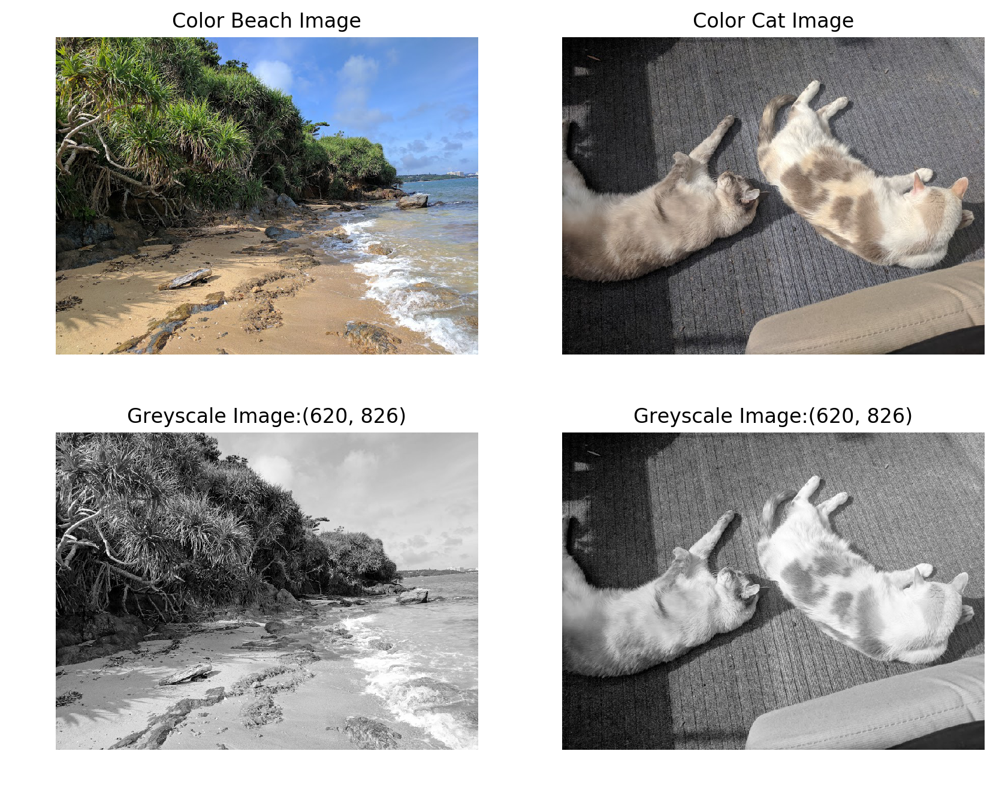

In [3]:
#Load an color image in and look at it
cbeach = cv2.imread('./images/testimages/beach.jpg')
cbeach = cv2.cvtColor(cbeach, cv2.COLOR_BGR2RGB)
beach = np.mean(cbeach,axis=2)
beach = beach - np.mean(beach)

ccats = cv2.imread('./images/testimages/cats.jpg')
ccats = cv2.cvtColor(ccats, cv2.COLOR_BGR2RGB)
cats = np.mean(ccats,axis=2)
cats = cats - np.mean(cats)

plt.figure(figsize=(10,8))

plt.subplot(2,2,1)
plt.imshow(cbeach)
plt.title('Color Beach Image')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(beach,cmap="Greys_r")
plt.title('Greyscale Image:{}'.format(np.shape(beach)))
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(ccats)
plt.title('Color Cat Image')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(cats,cmap="Greys_r")
plt.title('Greyscale Image:{}'.format(np.shape(cats)))
plt.axis('off')


(-0.5, 825.5, 619.5, -0.5)

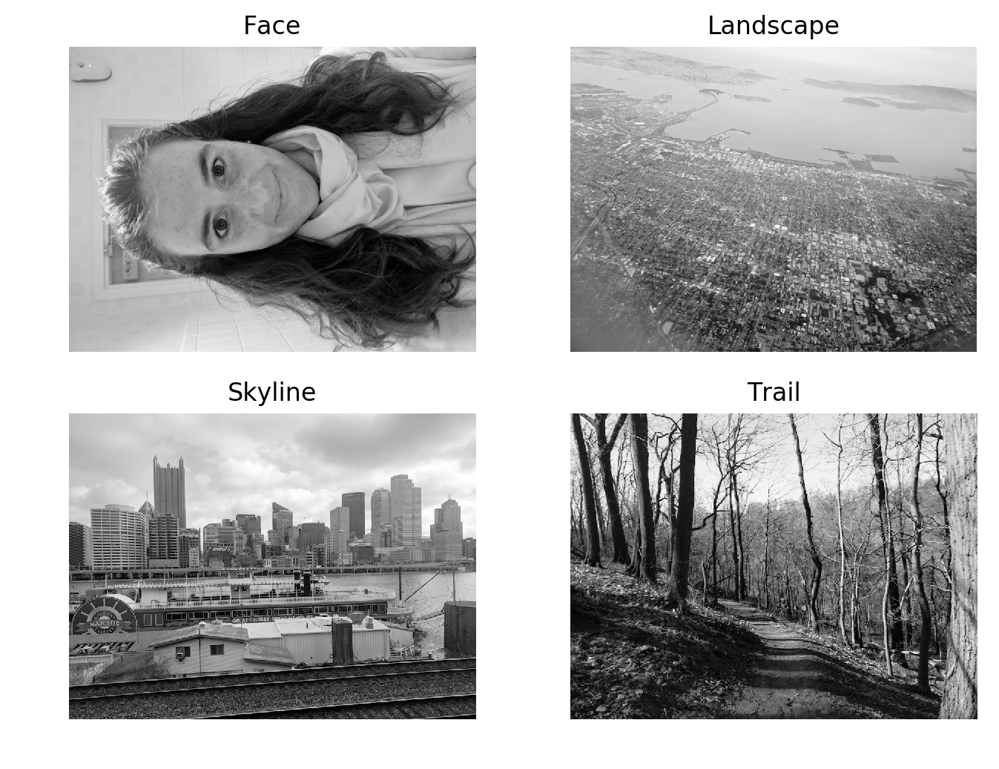

In [4]:
#face
face = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/face.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
face = face.T
face = face - np.mean(face)
#landscape
land = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/land.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
land = land - np.mean(land)
#skyline
skyline = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/skyline.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
skyline = skyline - np.mean(skyline)
#trail
trail = np.mean(cv2.cvtColor(cv2.imread('./images/testimages/trail.jpg'), cv2.COLOR_BGR2RGB),axis=-1)
trail = trail - np.mean(trail)

plt.figure(figsize=(8,6))
plt.subplot(2,2,1)
plt.imshow(face,cmap='Greys_r')
plt.title('Face')
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(land,cmap='Greys_r')
plt.title('Landscape')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(skyline,cmap='Greys_r')
plt.title('Skyline')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(trail,cmap='Greys_r')
plt.title('Trail')
plt.axis('off')

## Local Energy & Phase Congruency for a Simple Example - A Step Function

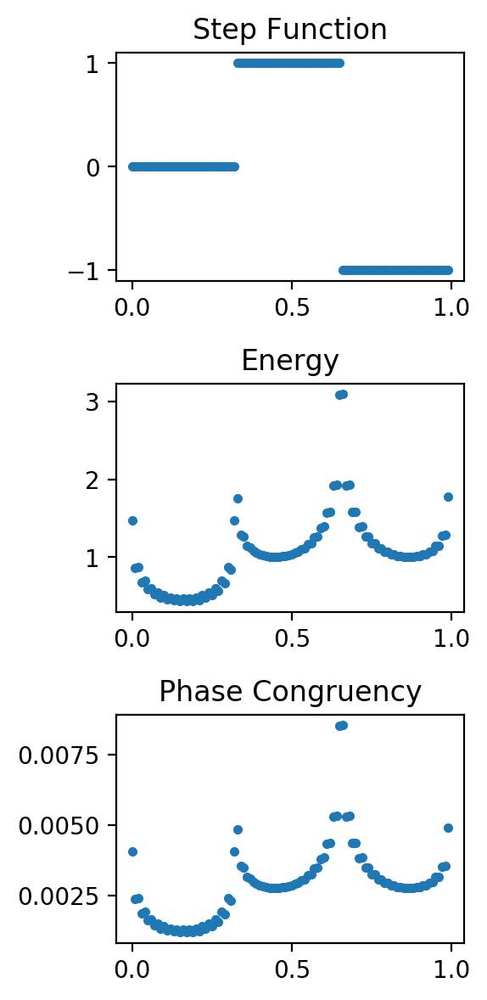

In [5]:
# def wrap2pi(angle):
#     anglewrapped = (angle) % (2 * np.pi) - np.pi
#     return anglewrapped

# def get_local_phase(t, w, phi):
#     local_phase = wrap2pi((t*w) + phi)
#     return(local_phase)

# def get_inst_phase(signal):
#     z = hilbert(signal)
#     inst_phase = np.unwrap(np.angle(z))

##In (Kolvesi, 2000) phase congruency is linearly related to the local energy, E, which is easier to caluclation.
def get_local_energy_1d(func):
    f = func
    #f = func - np.mean(func)
    h = np.imag(hilbert(f)) #h = hilbert transform of f
    energy = np.sqrt(np.square(f) + np.square(h))
    return(energy) 
    
#this function takes MUCH more compute.
def get_phase_congruency_1d(func):
    
#     ft = np.fft.fft(func)
#     freqs = np.fft.fftfreq(time)
#     global_amps = np.abs(ft)
#     global_phases = np.angle(ft)
    #local_amps = global_amps*np.exp(time*)
    energy = get_local_energy_1d(func)
    #pc_vals = energy / (func)
    pc_vals = energy / (np.sum(np.abs(np.fft.fft(func)))+0.01)
        
    return(pc_vals)

time = np.arange(0,1,1/100)
step_fun = np.append(np.append(np.zeros(33), np.ones(33)), -1*np.ones(34))

ft = np.fft.fft(step_fun)
fqs = np.fft.fftfreq(100,.01)
amp = np.abs(ft)
angle = np.angle(ft)

energy = get_local_energy_1d(step_fun)
pc = get_phase_congruency_1d(step_fun)

plt.figure(figsize=(3,6))

plt.subplot(3,1,1)
plt.plot(time,step_fun,'.')
plt.title('Step Function')

# plt.subplot(2,2,2)
# plt.plot(fqs, angle,'.')
# plt.title('Angle')

plt.subplot(3,1,2)
plt.plot(time, energy,'.')
plt.title('Energy')

plt.subplot(3,1,3)
plt.plot(time, pc,'.')
plt.title('Phase Congruency')

plt.tight_layout()


## Measure Phase Congruency in 2D

In [45]:
def measure_energy_axis(img,axis):
    e = np.apply_along_axis(get_local_energy_1d, axis, img) 
    return(e)

def measure_energy1_2d(func):
    hil = hilbert2(func)
    h = np.imag(hil)
    #f = np.real(hil)
    f = func
    energy2d = np.sqrt(np.square(f)+np.square(h))
    #phibar = np.arctan(h/f)
    phibar = np.arctan2(h,f)   
    return(energy2d, phibar)


def measure_pc1_2d(img, epsilon=0.001):
    a = np.abs(np.fft.fft2(img))+epsilon
    e, phibar = measure_energy1_2d(img)
    pc_vals = np.divide(e,np.mean(a))

    return(pc_vals, phibar)
    
def measure_energy2_2d(func):
    hil = hilbert2(func)
    h = np.imag(hil)
    #f = np.real(hil)
    f = func
    #phibar = np.arctan(h/f)
    phibar = np.arctan2(h,f)
    energy2d = np.multiply((np.cos(phibar) - np.abs(np.sin(phibar))), f) 
    return(energy2d, phibar)

def measure_energy_2d(img, en = 1, pbflag=True):
    # wrapper function to take care of two different e measurement types
    
    if(en==1):
        e_vals, phibar = measure_energy1_2d(img)
    elif(en==2):
        e_vals, phibar = measure_energy2_2d(img)

    if(pbflag==False):
        return(e_vals)
    else:
        return(e_vals, phibar)

    
def measure_pc2_2d(img, epsilon=0.001):

    a = np.abs(np.fft.fft2(img))+epsilon
    e, phibar = measure_energy2_2d(img)
    pc_vals = np.divide(e,np.sum(a))
    
    return(pc_vals, phibar)

    
def measure_pc_2d(img, pcn = 1, pbflag=True, epsilon= 0.001):
    # wrapper function to take care of two different pc measurement types
    
    if(pcn==1):
        pc_vals, phibar = measure_pc1_2d(img, epsilon)
    elif(pcn==2):
        pc_vals, phibar = measure_pc2_2d(img, epsilon)

    if(pbflag==False):
        return(pc_vals)
    else:
        return(pc_vals, phibar)
        

energy_cats, epb_cats = measure_energy_2d(cats)
energy_beach, epb_beach = measure_energy_2d(beach)

pc_cats, pb_cats = measure_pc2_2d(cats)
pc_beach, pb_beach = measure_pc2_2d(beach)

(-0.5, 825.5, 619.5, -0.5)

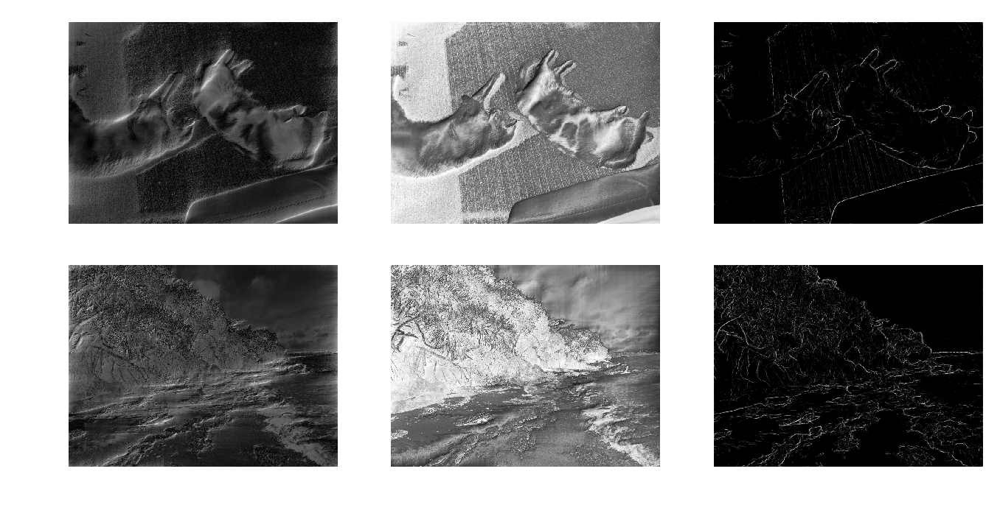

In [46]:
#compare three pc calculations
plt.figure(figsize=(8,4))
plt.subplot(2,3,1)
plt.imshow(measure_pc_2d(cats,pcn=1)[0],cmap='Greys_r')
plt.axis('off')
plt.subplot(2,3,2)
plt.imshow(measure_pc_2d(cats,pcn=2)[0],cmap='Greys_r')
plt.axis('off')
plt.subplot(2,3,3)
plt.imshow(pp.phasecong(cats)[0],cmap='Greys_r')
plt.axis('off')
plt.subplot(2,3,4)
plt.imshow(measure_pc_2d(beach,pcn=1)[0],cmap='Greys_r')
plt.axis('off')
plt.subplot(2,3,5)
plt.imshow(measure_pc_2d(beach,pcn=2)[0],cmap='Greys_r')
plt.axis('off')
plt.subplot(2,3,6)
plt.imshow(pp.phasecong(beach)[0],cmap='Greys_r')
plt.axis('off')

In [48]:
#redo calculations
ft_beach = np.fft.fftshift(np.fft.fft2(beach))
amp_beach = np.abs(ft_beach)
angle_beach = np.angle(ft_beach)
pc_beach, pb_beach = measure_pc_2d(beach)
#pc_beach = pp.phasecong(beach)

ft_cats = np.fft.fftshift(np.fft.fft2(cats))
amp_cats = np.abs(ft_cats)
angle_cats = np.angle(ft_cats)
pc_cats, pb_cats = measure_pc_2d(cats)
#pc_cats = pp.phasecong(cats)

ft_face = np.fft.fftshift(np.fft.fft2(face))
amp_face = np.abs(ft_face)
angle_face = np.angle(ft_face)
pc_face, pb_face = measure_pc_2d(face)

ft_land = np.fft.fftshift(np.fft.fft2(land))
amp_land = np.abs(ft_land)
angle_land = np.angle(ft_land)
pc_land, pb_land = measure_pc_2d(land)

ft_skyline = np.fft.fftshift(np.fft.fft2(skyline))
amp_skyline = np.abs(ft_skyline)
angle_skyline = np.angle(ft_skyline)
pc_skyline, pb_skyline = measure_pc_2d(skyline)

ft_trail = np.fft.fftshift(np.fft.fft2(trail))
amp_trail = np.abs(ft_trail )
angle_trail = np.angle(ft_trail)
pc_trail, pb_trail = measure_pc_2d(trail)

recon_beach = np.fft.ifft2(np.fft.ifftshift(amp_beach* np.exp(1j*angle_beach)))
recon_cats = np.fft.ifft2(np.fft.ifftshift(amp_cats* np.exp(1j*angle_cats)))
recon_anglebeach_ampcats = np.fft.ifft2(np.fft.ifftshift(amp_cats* np.exp(1j*angle_beach)))
recon_anglcats_ampbeach = np.fft.ifft2(np.fft.ifftshift(amp_beach* np.exp(1j*angle_cats)))

In [18]:
def set_thresh(m,tmin=0.4):
    m = dists.rescale(m)
    supra_threshold_indices = m < tmin
    mthresh = np.ones_like(m)
    mthresh[supra_threshold_indices] = 0
    return(mthresh)

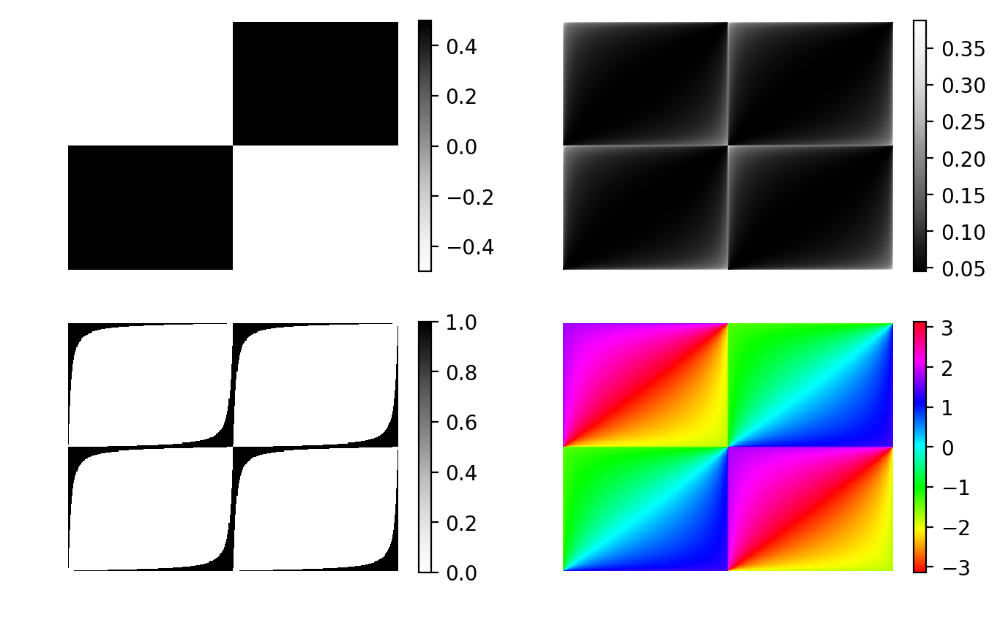

In [19]:
#test on grid
grid = np.vstack([np.zeros((np.divide(np.shape(cats),2)).astype(int)),np.ones(np.divide(np.shape(cats),2).astype(int))])
grid = np.hstack([grid,np.flip(grid,0)])
grid = dists.rescale(grid)
grid = grid - np.mean(grid)
pc_grid = pp.phasecong(grid)[0]
pc_grid, pb_grid = measure_pc_2d(grid)
pc_grid_thresh = set_thresh(pc_grid,tmin = 0.2)


plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(grid,cmap='Greys')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pc_grid,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pc_grid_thresh,cmap='Greys')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pb_grid,cmap='hsv')
plt.axis('off')
plt.colorbar()

(-0.5, 524.5, 404.5, -0.5)

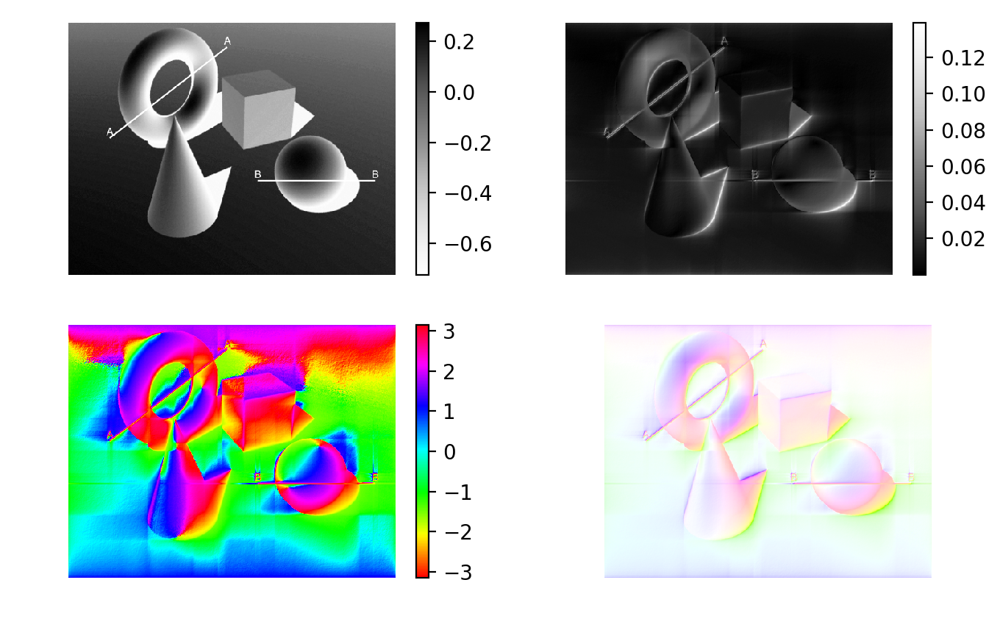

In [20]:
#test on blockworld
cblocks = cv2.imread('./images/testimages/blockworld.png')
cblocks = cv2.cvtColor(cblocks, cv2.COLOR_BGR2RGB)
#print(blocks.shape)
blocks = np.mean(cblocks,axis=2)
blocks = dists.rescale(blocks)
blocks= blocks - np.mean(blocks)
pc_blocks, pb_blocks = measure_pc_2d(blocks)
#pc_blocks = pp.phasecong(blocks)[0]


hsv = mpl.cm.get_cmap('hsv')
# since pb_leaves goes from -np.pi to np.pi, we can normailize it like so
pb_blocks_cmap = hsv(pb_blocks/np.pi/2+0.5)
pb_blocks_cmap[...,-1] = pc_blocks / np.max(pc_blocks)


pc_blocks_thresh = set_thresh(pc_blocks,tmin = 0.3)


plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(blocks,cmap='Greys')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pc_blocks,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pb_blocks,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pb_blocks_cmap)
plt.axis('off')

(-0.5, 979.5, 993.5, -0.5)

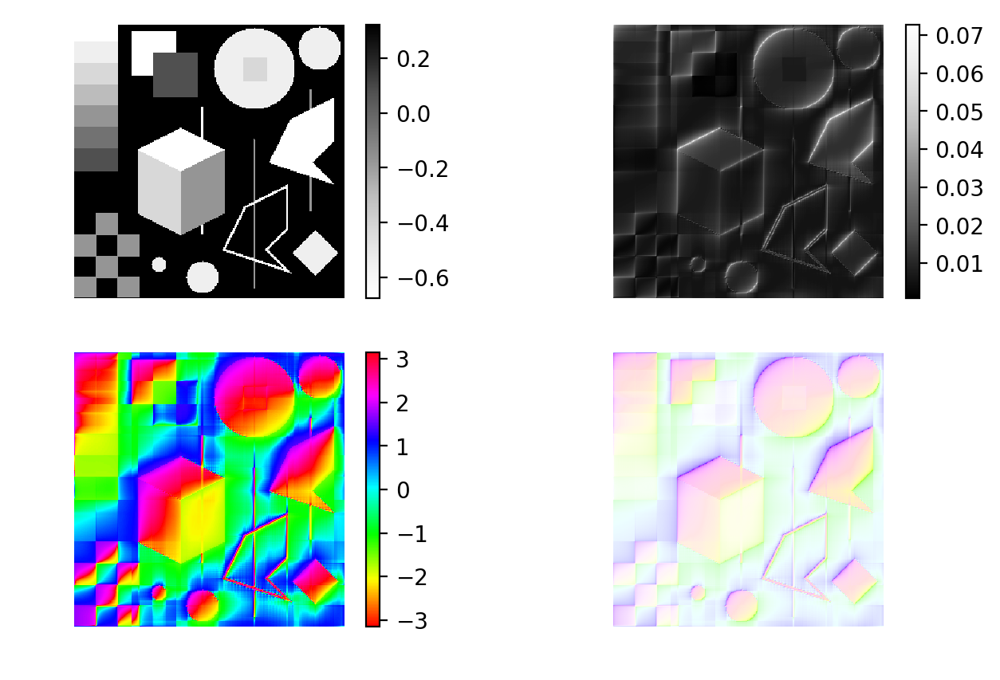

In [21]:
#test on shapes
cshapes = cv2.imread('./images/testimages/shapes.png')
cshapes = cv2.cvtColor(cshapes, cv2.COLOR_BGR2RGB)
#print(blocks.shape)
shapes = np.mean(cshapes,axis=2)
shapes = dists.rescale(shapes)
shapes = shapes - np.mean(shapes)
pc_shapes, pb_shapes = measure_pc_2d(shapes)
#pc_shapes = pp.phasecong(shapes)[0]


hsv = mpl.cm.get_cmap('hsv')
# since pb_leaves goes from -np.pi to np.pi, we can normailize it like so
pb_shapes_cmap = hsv(pb_shapes/np.pi/2+0.5)
pb_shapes_cmap[...,-1] = pc_shapes / np.max(pc_shapes)


pc_shapes_thresh = set_thresh(pc_shapes,tmin = 0.3)

plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(shapes,cmap='Greys')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pc_shapes,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pb_shapes,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pb_shapes_cmap)
plt.axis('off')

(-0.5, 1187.5, 1179.5, -0.5)

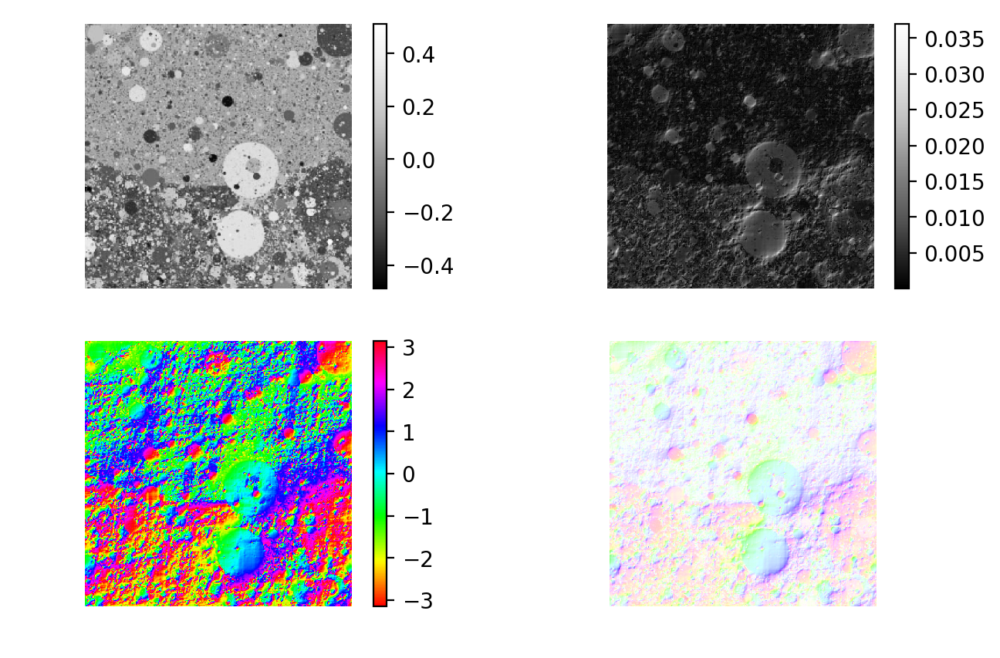

In [22]:
#test on dead leaves
cleaves = cv2.imread('./images/testimages/deadleaves.png')
cleaves = cv2.cvtColor(cleaves, cv2.COLOR_BGR2RGB)
#print(blocks.shape)
leaves = np.mean(cleaves,axis=2)
leaves = dists.rescale(leaves)
leaves = leaves - np.mean(leaves)
pc_leaves, pb_leaves = measure_pc_2d(leaves)
#pc_leaves = pp.phasecong(leaves)[0]

hsv = mpl.cm.get_cmap('hsv')
# since pb_leaves goes from -np.pi to np.pi, we can normailize it like so
pb_leaves_cmap = hsv(pb_leaves/np.pi/2+0.5)
pb_leaves_cmap[...,-1] = pc_leaves / np.max(pc_leaves)


pc_leaves_thresh = set_thresh(pc_leaves,tmin = 0.2)




plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(leaves,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pc_leaves,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

# plt.subplot(2,2,3)
# plt.imshow(pc_leaves_thresh,cmap='Greys')
# plt.axis('off')
# plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pb_leaves,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pb_leaves_cmap)
plt.axis('off')

(-0.5, 774.5, 776.5, -0.5)

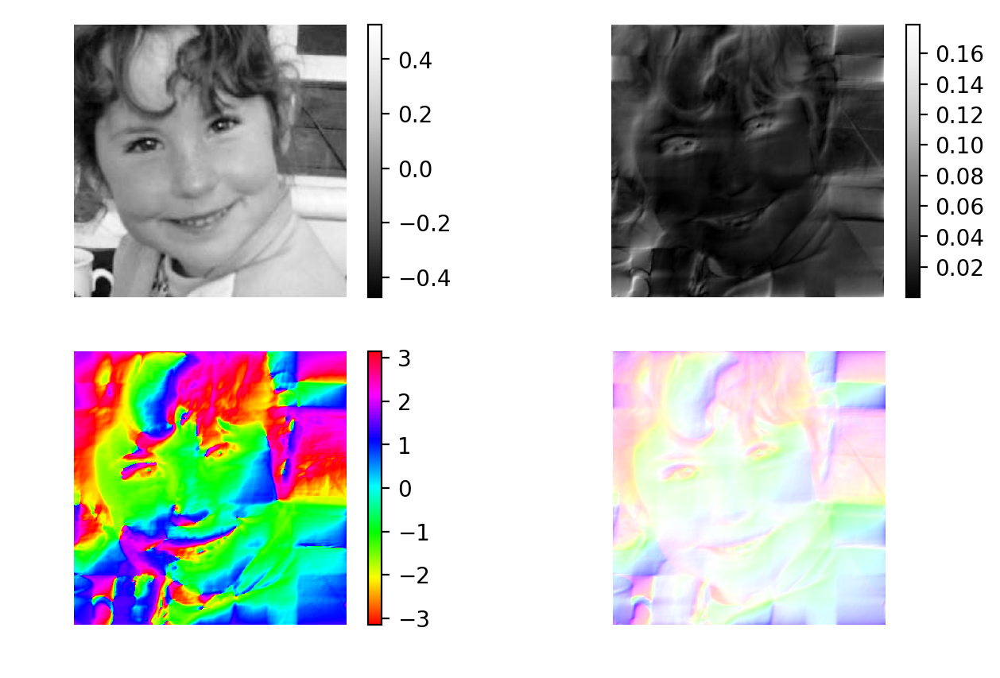

In [23]:
#test on childface from kovesi's thesis
cchild = cv2.imread('./images/testimages/child.png')
cchild = cv2.cvtColor(cchild, cv2.COLOR_BGR2RGB)
child = np.mean(cchild,axis=2)
child = dists.rescale(child)
child = child - np.mean(child)
pc_child, pb_child = measure_pc_2d(child)
#pc_child = pp.phasecong(child)[0]

# since pb_leaves goes from -np.pi to np.pi, we can normailize it like so
pb_child_cmap = hsv(pb_child/np.pi/2+0.5)
pb_child_cmap[...,-1] = pc_child / np.max(pc_child)


pc_child_thresh = set_thresh(pc_child,tmin = 0.3)


plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(child,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pc_child,cmap='Greys_r')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pb_child,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pb_child_cmap)
plt.axis('off')


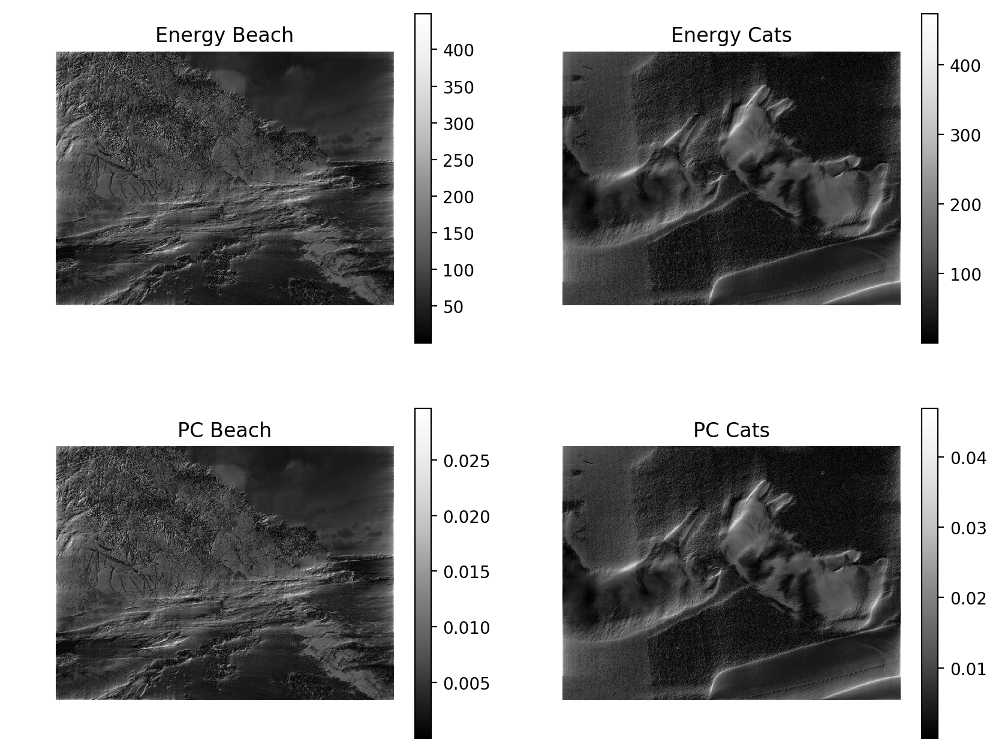

In [24]:
energy_cats, epb_cats = measure_energy_2d(cats)
energy_beach, epb_beach = measure_energy_2d(beach)
pc_cats, pb_cats = measure_pc_2d(cats)
pc_beach, pb_cats = measure_pc_2d(beach)

plt.figure(figsize=(10,8))

plt.subplot(2,2,1)
plt.imshow(energy_beach, cmap="Greys_r")
plt.title('Energy Beach')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(energy_cats, cmap="Greys_r")
plt.title('Energy Cats')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pc_beach, cmap="Greys_r")
plt.title('PC Beach')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(pc_cats, cmap="Greys_r")
plt.title('PC Cats')
plt.axis('off')
plt.colorbar()

(-0.5, 825.5, 619.5, -0.5)

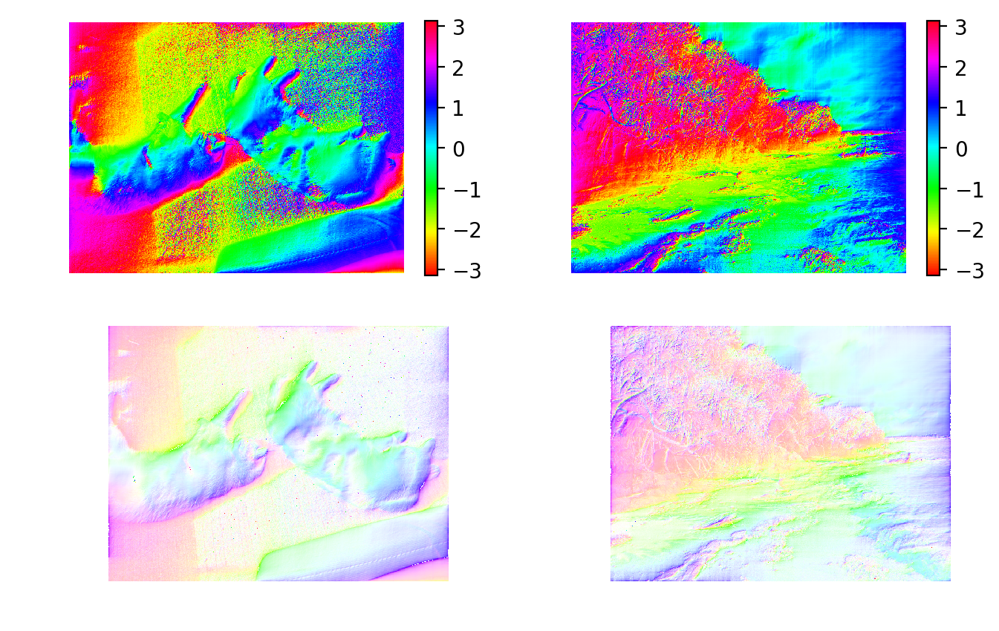

In [51]:
pb_cats_cmap = hsv(pb_cats/np.pi/2+0.5)
pb_cats_cmap[...,-1] = np.exp(pc_cats / np.max(pc_cats))

pb_beach_cmap = hsv(pb_beach/np.pi/2+0.5)
pb_beach_cmap[...,-1] = np.exp(pc_beach / np.max(pc_beach))

plt.figure(figsize=(8,5))

plt.subplot(2,2,1)
plt.imshow(pb_cats,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(pb_beach,cmap='hsv')
plt.axis('off')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(pb_cats_cmap)
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(pb_beach_cmap)
plt.axis('off')

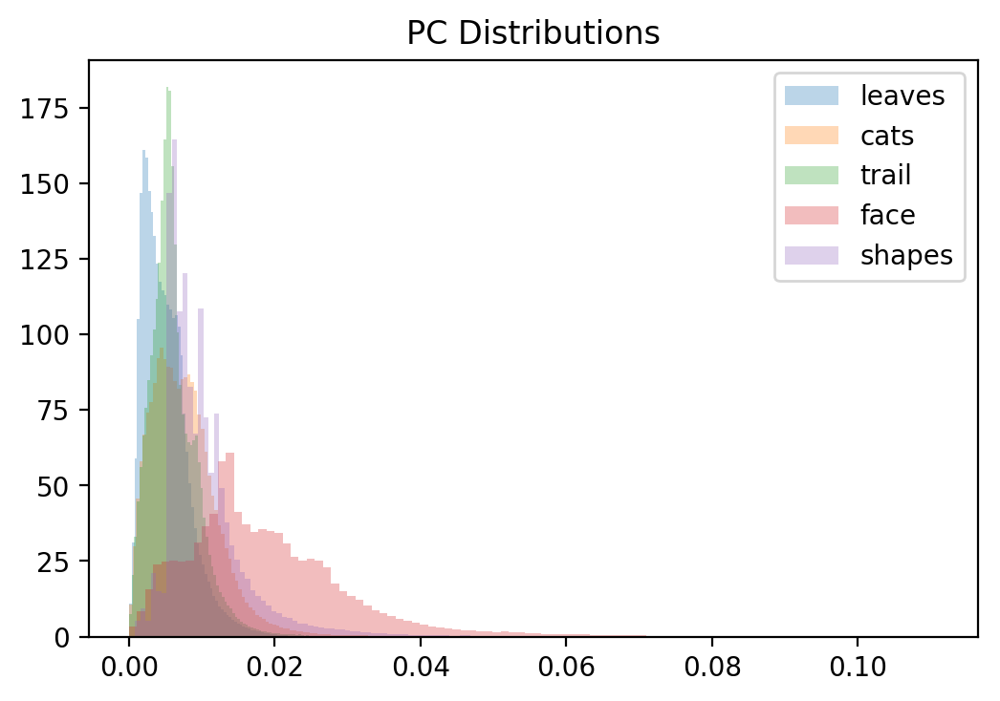

In [25]:
plt.hist(pc_leaves.flatten(),bins=100,label='leaves',normed=True,alpha=0.3);
plt.hist(pc_cats.flatten(),bins=100,label='cats',normed=True,alpha=0.3);
plt.hist(pc_trail.flatten(),bins=100,label='trail',normed=True,alpha=0.3);
plt.hist(pc_face.flatten(),bins=100,label='face',normed=True,alpha=0.3);
plt.hist(pc_shapes.flatten(),bins=100,label='shapes',normed=True,alpha=0.3);
plt.title('PC Distributions')
plt.legend()

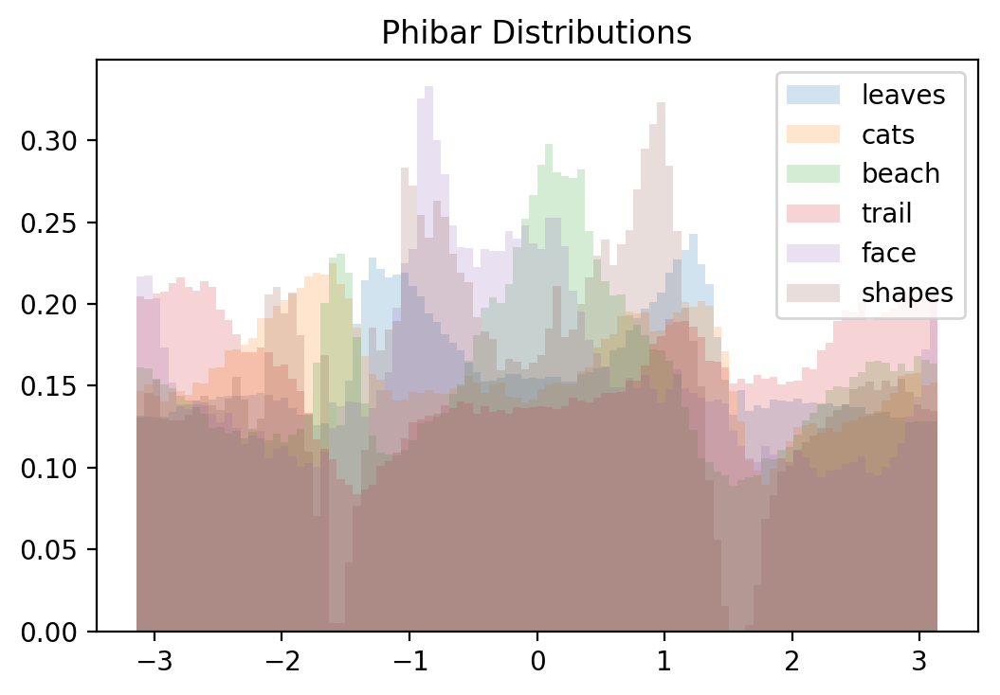

In [50]:
alp = 0.2

plt.hist(pb_leaves.flatten(),bins=100,label='leaves',normed=True,alpha=alp);
plt.hist(pb_cats.flatten(),bins=100,label='cats',normed=True,alpha=alp);
plt.hist(pb_beach.flatten(),bins=100,label='beach',normed=True,alpha=alp);
plt.hist(pb_trail.flatten(),bins=100,label='trail',normed=True,alpha=alp);
plt.hist(pb_face.flatten(),bins=100,label='face',normed=True,alpha=alp);
plt.hist(pb_shapes.flatten(),bins=100,label='shapes',normed=True,alpha=alp);
plt.title('Phibar Distributions')
plt.legend()

cool! These are definitely NOT uniform. They look oddly symmetric too, which is interesting. Perhaps this is symmetry in objects?

## What does Noise look like in terms of local energy spectrum?

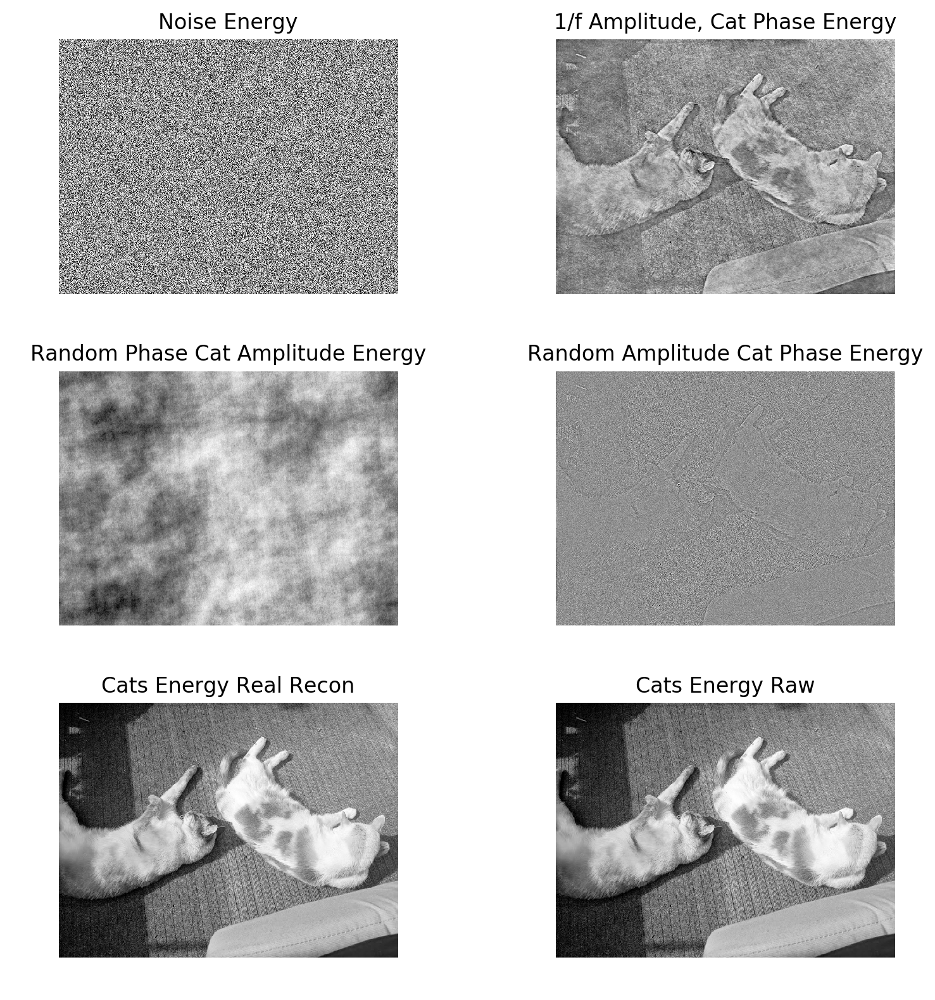

In [134]:
#cats phase, 1/f amplitude
#recon_onef_cats
#redo phase and angle without cosine window
ft_cwcats = np.fft.fft2(cats)

f_alpha = 1.0
f_k = 100000

def make_onef(shape, alpha, k):
    y, x = np.indices(shape)
    center = np.array(shape)/2
    r = np.hypot(x - center[1], y - center[0])
    amp = k/(1+r**alpha)
    return amp
    
amp_onef = make_onef(np.shape(cats),f_alpha, f_k)
rand_noise = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])
rand_noise_1 = np.random.rand(np.shape(angle_cats)[0],np.shape(angle_cats)[1])*2*np.pi

#1/f amplitude, unifrom phase
recon_onef_unif =  np.real(np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*rand_noise_1))))

#random phase, random amplitude
random_noise = np.random.rand(np.shape(cats)[0],np.shape(cats)[1])
#cat phase 1/f amplitude
recon_onef_cats = np.real(np.fft.ifft2(np.fft.ifftshift(amp_onef*np.exp(1j*angle_cats))))
#random phase, cat amplitude
recon_rand_phase_cats_1 = np.real(np.fft.ifft2(np.fft.ifftshift(amp_cats*np.exp(1j*rand_noise_1))))
#cat phase, random amplitude
recon_rand_cats = np.real(np.fft.ifft2(np.fft.ifftshift(rand_noise*np.exp(1j*angle_cats))))
#cat recon
recon_cats = np.real(np.fft.ifft2(np.fft.fft2(cats)))
#cat original
#cats

plt.figure(figsize=(8,8))

plt.subplot(3,2,1)
plt.imshow(random_noise, cmap = 'Greys_r')
plt.title('Noise Energy')
plt.axis('off')

plt.subplot(3,2,2)
plt.imshow(recon_onef_cats, cmap = 'Greys_r')
plt.title('1/f Amplitude, Cat Phase Energy')
plt.axis('off')

plt.subplot(3,2,3)
plt.imshow(recon_rand_phase_cats_1, cmap = 'Greys_r')
plt.title('Random Phase Cat Amplitude Energy')
plt.axis('off')

plt.subplot(3,2,4)
plt.imshow(recon_rand_cats, cmap = 'Greys_r')
plt.title('Random Amplitude Cat Phase Energy')
plt.axis('off')

plt.subplot(3,2,5)
plt.imshow(np.real(recon_cats), cmap = 'Greys_r')
plt.title('Cats Energy Real Recon')
plt.axis('off')

plt.subplot(3,2,6)
plt.imshow(cats, cmap = 'Greys_r')
plt.title('Cats Energy Raw')
plt.axis('off')

plt.tight_layout()

## Reconstruct from phibar and E

5.060053156299823e-29 6.176845341226745e-29


(-0.5, 825.5, 619.5, -0.5)

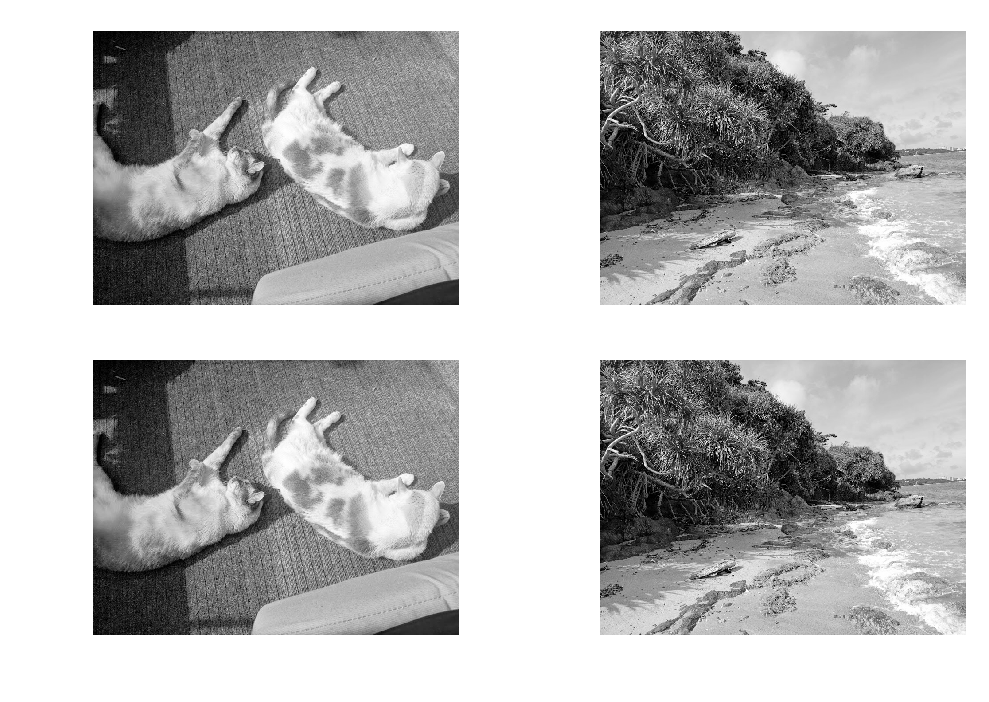

In [47]:
def pc_recon_im(phibar, e):
    im = np.multiply(np.cos(phibar),e)
    return(im)

energy_cats, epb_cats = measure_energy_2d(cats)
pc_cats, pb_cats = measure_pc_2d(cats)
energy_beach, epb_beach = measure_energy_2d(beach)
pc_beach, pb_beach = measure_pc_2d(beach)

cats_pc_recon = pc_recon_im(epb_cats, energy_cats)
beach_pc_recon = pc_recon_im(epb_beach, energy_beach)

#calc MSE
cats_pc_recon_mse = ((cats_pc_recon - cats) ** 2).mean()
beach_pc_recon_mse = ((beach_pc_recon - beach) ** 2).mean()
print(cats_pc_recon_mse, beach_pc_recon_mse)

plt.subplot(2,2,1)
plt.imshow(cats,cmap='Greys_r')
plt.axis('off')

plt.subplot(2,2,2)
plt.imshow(beach,cmap='Greys_r')
plt.axis('off')

plt.subplot(2,2,3)
plt.imshow(cats_pc_recon,cmap='Greys_r')
plt.axis('off')

plt.subplot(2,2,4)
plt.imshow(beach_pc_recon,cmap='Greys_r')
plt.axis('off')


this worked REALLY well. We should be able to sample now.

Text(0.5,1,'PC beach, PB cats')

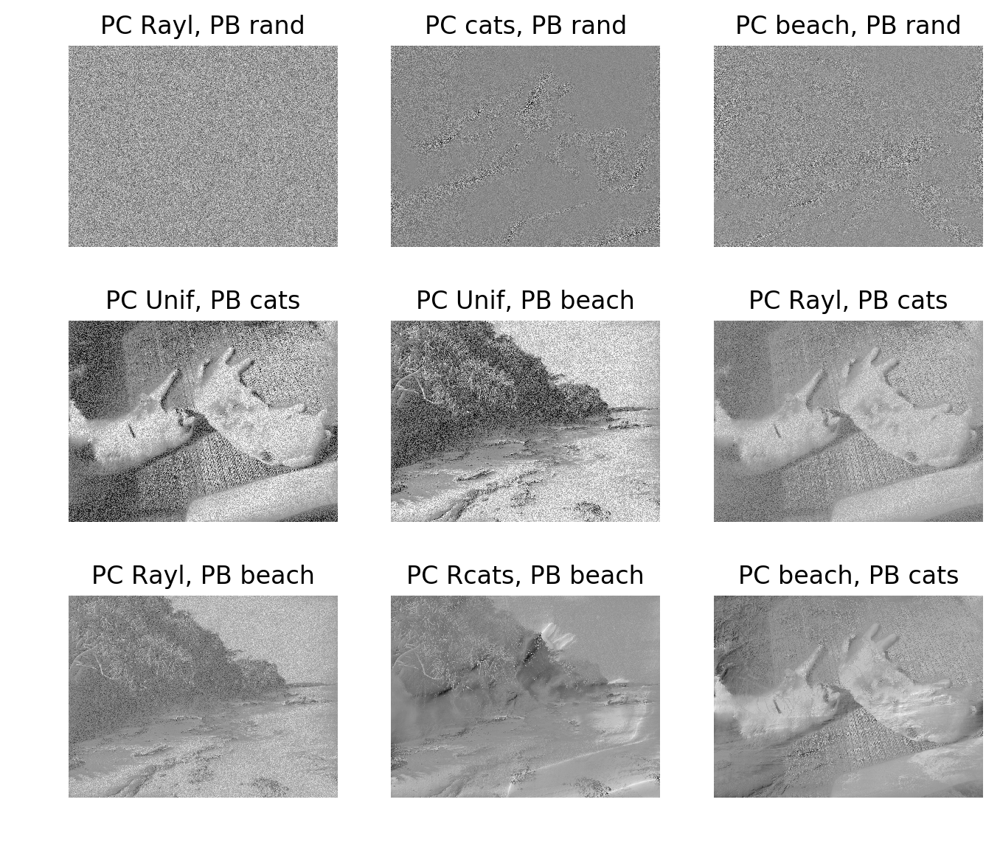

In [142]:
pb_unif = np.random.uniform(-np.pi, np.pi, np.shape(pb_cats))
pc_rayl = np.random.rayleigh(1, np.shape(pc_cats))
pc_unif = np.random.uniform(0,1,np.shape(pc_cats))

rayl_pc_rand_pc_recon = pc_recon_im(pb_unif, pc_rayl)

cats_pc_rand_pb_recon = pc_recon_im(pb_unif, energy_cats)
beach_pc_rand_pb_recon = pc_recon_im(pb_unif, energy_beach)

unif_pc_cats_pb_recon = pc_recon_im(pb_cats, pc_unif)
unif_pc_beach_pb_recon = pc_recon_im(pb_beach, pc_unif)

rayl_pc_cats_pb_recon = pc_recon_im(pb_cats, pc_rayl)
rayl_pc_beach_pb_recon = pc_recon_im(pb_beach, pc_rayl)

cats_pc_beach_pb = pc_recon_im(pb_beach, pc_cats)
beach_pc_cats_pb = pc_recon_im(pb_cats, pc_beach)


plt.figure(figsize=(8,7))

plt.subplot(3,3,1)
plt.imshow(rayl_pc_rand_pc_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC Rayl, PB rand')

plt.subplot(3,3,2)
plt.imshow(cats_pc_rand_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC cats, PB rand')

plt.subplot(3,3,3)
plt.imshow(beach_pc_rand_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC beach, PB rand')

plt.subplot(3,3,4)
plt.imshow(unif_pc_cats_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC Unif, PB cats')

plt.subplot(3,3,5)
plt.imshow(unif_pc_beach_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC Unif, PB beach')

plt.subplot(3,3,6)
plt.imshow(rayl_pc_cats_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC Rayl, PB cats')

plt.subplot(3,3,7)
plt.imshow(rayl_pc_beach_pb_recon,cmap='Greys_r')
plt.axis('off')
plt.title('PC Rayl, PB beach')

plt.subplot(3,3,8)
plt.imshow(cats_pc_beach_pb,cmap='Greys_r')
plt.axis('off')
plt.title('PC Rcats, PB beach')

plt.subplot(3,3,9)
plt.imshow(beach_pc_cats_pb,cmap='Greys_r')
plt.axis('off')
plt.title('PC beach, PB cats')

Hmmm, it looks again like the important salient information is in in the phibar (phase) information! Will sampling work then? 

Text(0.5,1,'Generated Image')

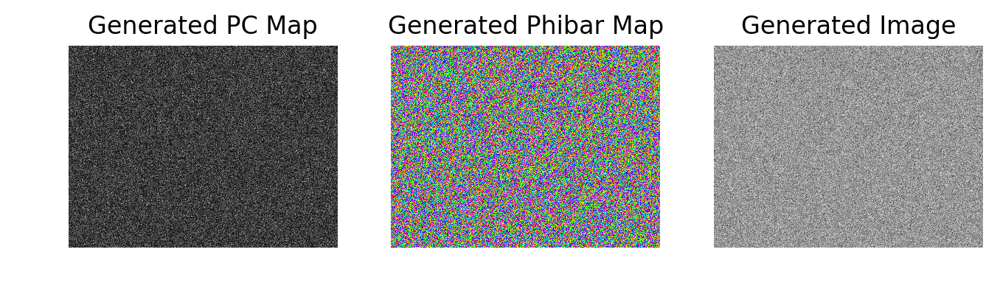

In [95]:
sample_pc, sample_pb = measure_pc_2d(rayl_pc_rand_pc_recon)

plt.figure(figsize=(8,3))

plt.subplot(1,3,1)
plt.imshow(sample_pc,cmap='Greys_r')
plt.axis('off')
plt.title('Generated PC Map')
plt.subplot(1,3,2)
plt.imshow(sample_pb,cmap='hsv')
plt.axis('off')
plt.title('Generated Phibar Map')
plt.subplot(1,3,3)
plt.imshow(rayl_pc_rand_pc_recon,cmap='Greys_r')
plt.axis('off')
plt.title('Generated Image')

(-0.5, 825.5, 619.5, -0.5)

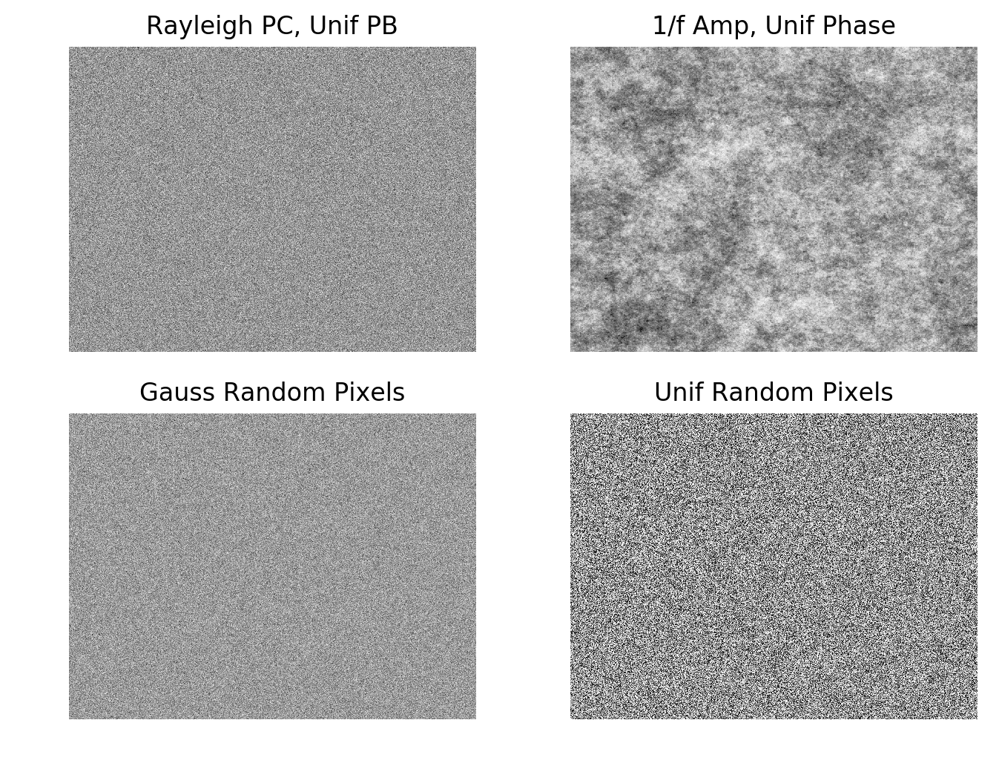

In [135]:
plt.figure(figsize=(8,6))

plt.subplot(2,2,1)
plt.imshow(rayl_pc_rand_pc_recon,cmap='Greys_r')
plt.title('Rayleigh PC, Unif PB')
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(recon_onef_unif,cmap='Greys_r')
plt.title('1/f Amp, Unif Phase')
plt.axis('off')
plt.subplot(2,2,4)
plt.imshow(np.random.rand(*np.shape(cats)),cmap='Greys_r')
plt.title('Unif Random Pixels')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(np.random.randn(*np.shape(cats)),cmap='Greys_r')
plt.title('Gauss Random Pixels')
plt.axis('off')

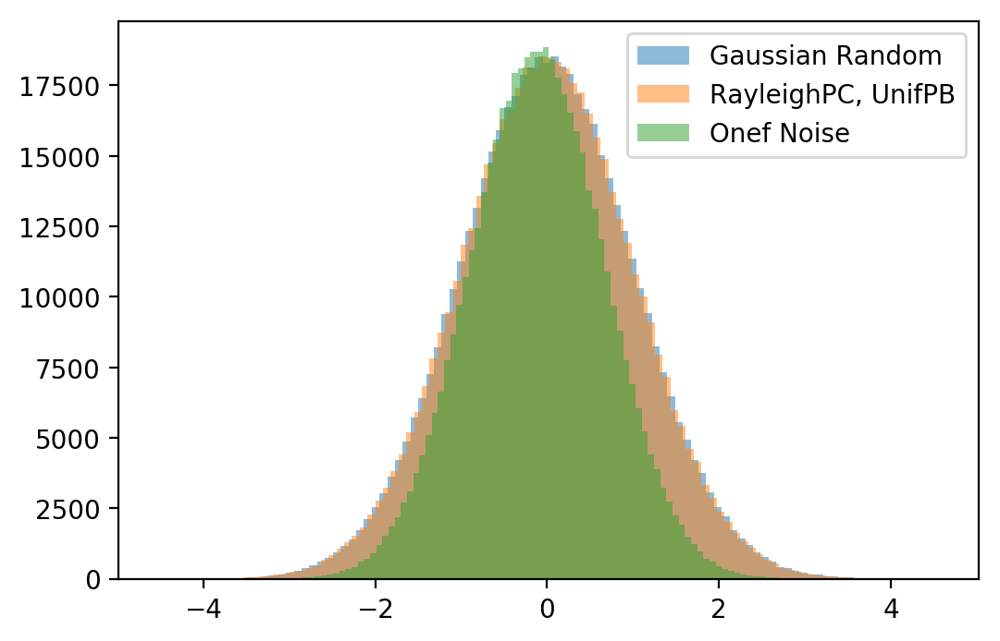

In [137]:
aval= 0.5
plt.hist(np.random.randn(*np.shape(cats)).flatten(),bins=100,label='Gaussian Random', alpha = aval);
plt.hist(rayl_pc_rand_pc_recon.flatten(),bins=100,label='RayleighPC, UnifPB', alpha = aval);
plt.hist(recon_onef_unif.flatten(),bins=100,label='Onef Noise', alpha = aval);
plt.legend()

OK, so these images have the desired distribution, but spatially the edges are distributed. Seems we need to make these images follow the autocorrelation properties of natural iamges in their pc maps, not just the same flattened distrbution.

(496335, 144)
(496335, 144)


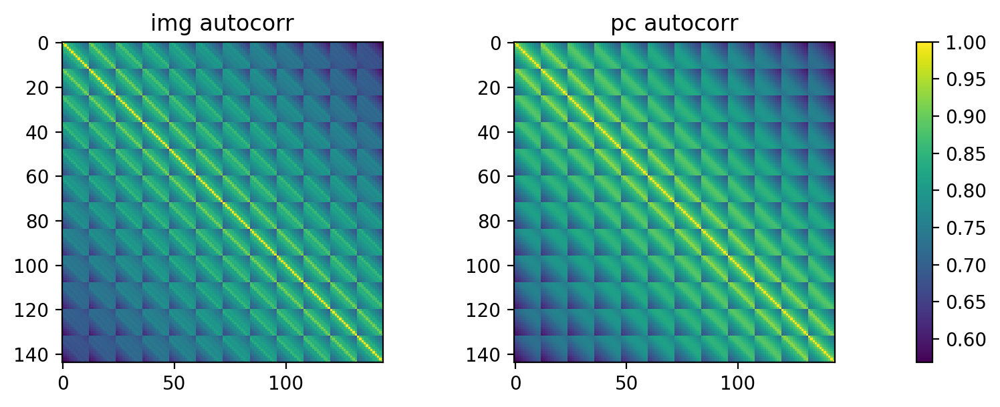

In [87]:
##corr = scp.signal.correlate2d(indoor_ims[0],indoor_ims[0])
def get_2dcorr(im,edge=12):
    #make patches of edgesize by edgesize
    from sklearn.feature_extraction.image import extract_patches_2d
    #vpatches = np.array([image.extract_patches_2d(im, (edge,edge)) for im in ims])
    vpatches = np.array(extract_patches_2d(im, (edge,edge)))
    vpatches = vpatches.reshape(-1,edge*edge) #patchsize we want
#     patches = patches.reshape(-1,edge*edge)
#     patches = patches.reshape(-1,edge,edge)
    #patches = vpatches.reshape(-1,edge,edge)
    print(vpatches.shape)
    corr = np.corrcoef(vpatches,rowvar=False)
    #print(corr)
    #corr = corr.reshape()
    #return(corr)
    return(corr)

pccorr = get_2dcorr(pc_cats)
imcorr = get_2dcorr(cats)


plt.figure(figsize=(8,3))
plt.subplot(1,2,1)
plt.imshow(imcorr)
plt.title('img autocorr')

plt.subplot(1,2,2)
plt.title('pc autocorr')
plt.imshow(pccorr)

plt.subplots_adjust(bottom=0.1, right=0.9, top=0.9)
cax = plt.axes([0.95, 0.1, 0.015, 0.8])
plt.colorbar(cax=cax)
plt.show()

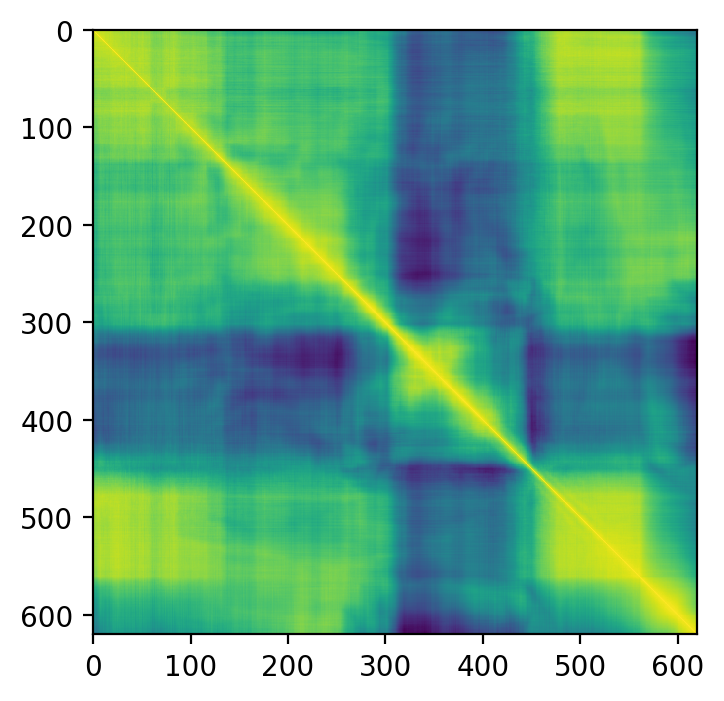

In [73]:
ccf = np.corrcoef(cats)
plt.imshow(ccf)

In [ ]:
#average over all pixles
# calculate cross correlation (Dong & Atick 1995a)
##time separation in miliseconds at 25 fps min separation is 40ms.
dtms = 100
#time separation in frames
df = 1
j=0

def get_ccfs(vm,dtms,df,j):
    onecc = np.corrcoef(vm[j,0:100,i], vm[j+df,0:100,i])
    onecc
    return(ccfs)

ccfs = get_ccfs(vm,dtms,df,j)

print(ccfs)

## Threshodl Phase Congruency for Edge Detection

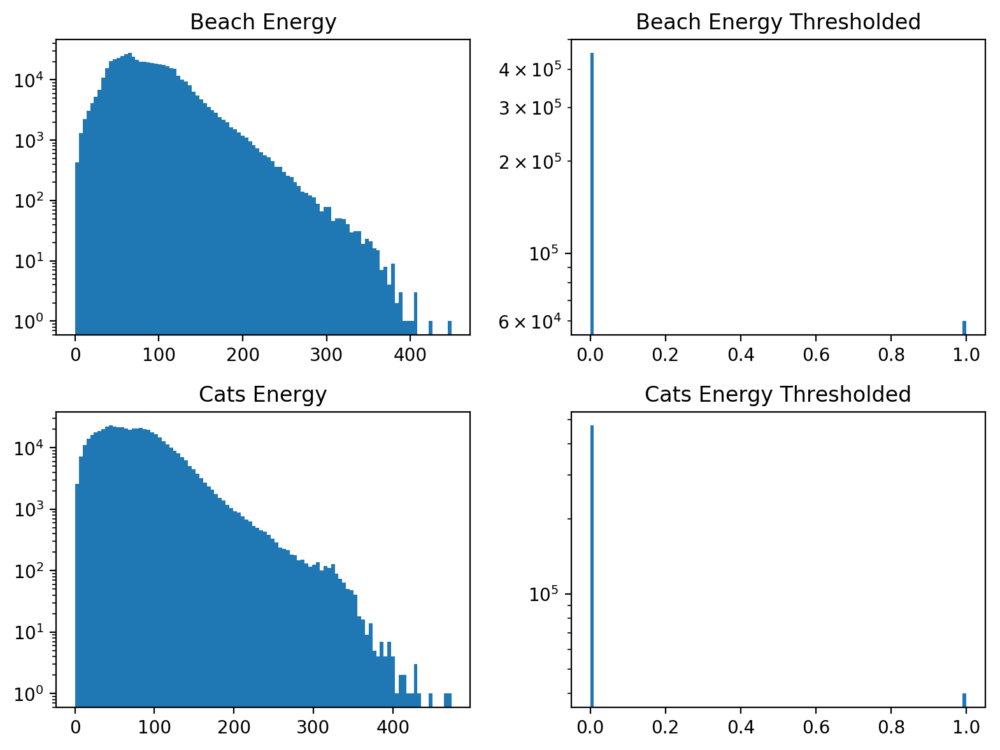

In [29]:
energy_beach_thresh = set_thresh(energy_beach, 0.3)
energy_cats_thresh = set_thresh(energy_cats, 0.3)

plt.figure(figsize=(8,6))

plt.subplot(2,2,1)
plt.hist(energy_beach.flatten(),log="y", bins=100)
plt.title('Beach Energy')

plt.subplot(2,2,2)
plt.hist(energy_beach_thresh.flatten(), log="y", bins=100)
plt.title('Beach Energy Thresholded')

plt.subplot(2,2,3)
plt.hist(energy_cats.flatten(), log="y", bins=100)
plt.title('Cats Energy')

plt.subplot(2,2,4)
plt.hist(energy_cats_thresh.flatten(), log="y", bins=100)
plt.title('Cats Energy Thresholded')

plt.tight_layout()

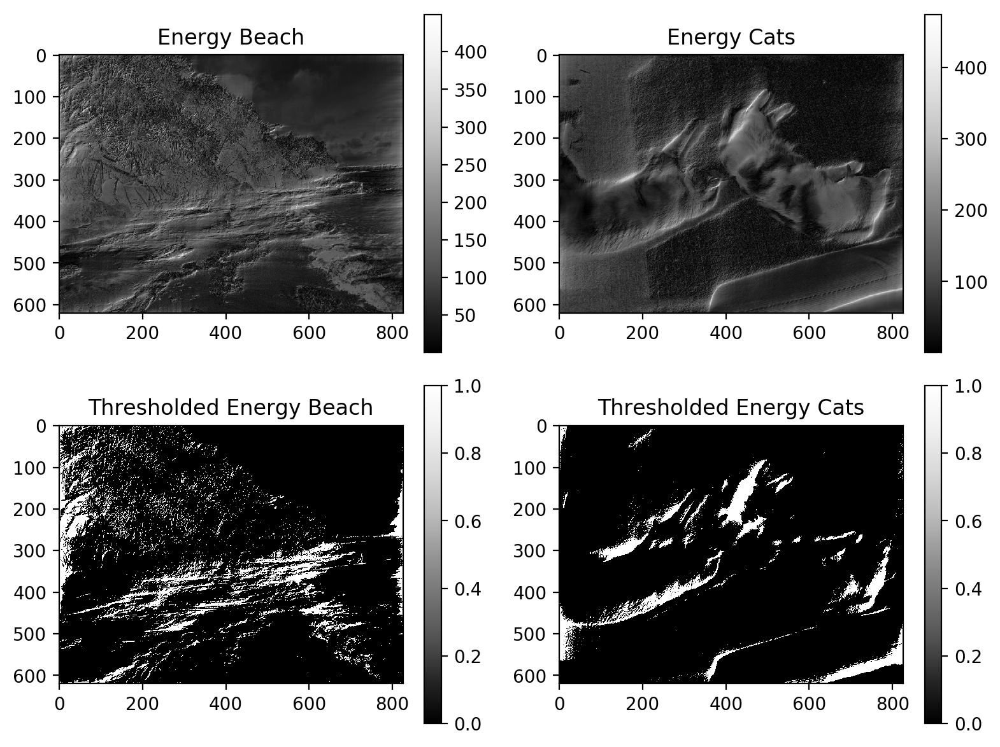

In [30]:
plt.figure(figsize=(8,6))

plt.subplot(2,2,1)
plt.imshow(energy_beach,cmap="Greys_r")
plt.title('Energy Beach')
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(energy_cats,cmap="Greys_r")
plt.title('Energy Cats')
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(energy_beach_thresh,cmap="Greys_r")
plt.title('Thresholded Energy Beach')
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(energy_cats_thresh,cmap="Greys_r")
plt.title('Thresholded Energy Cats')
plt.colorbar()


plt.tight_layout()

we could make this more like the kovesi edge detector by many methods discussed in their paper. I think what would help most is the thresholded window. We aren't interested in making an amazing edge detector here, Kovesi has done this.

## X and Y Energy Separately

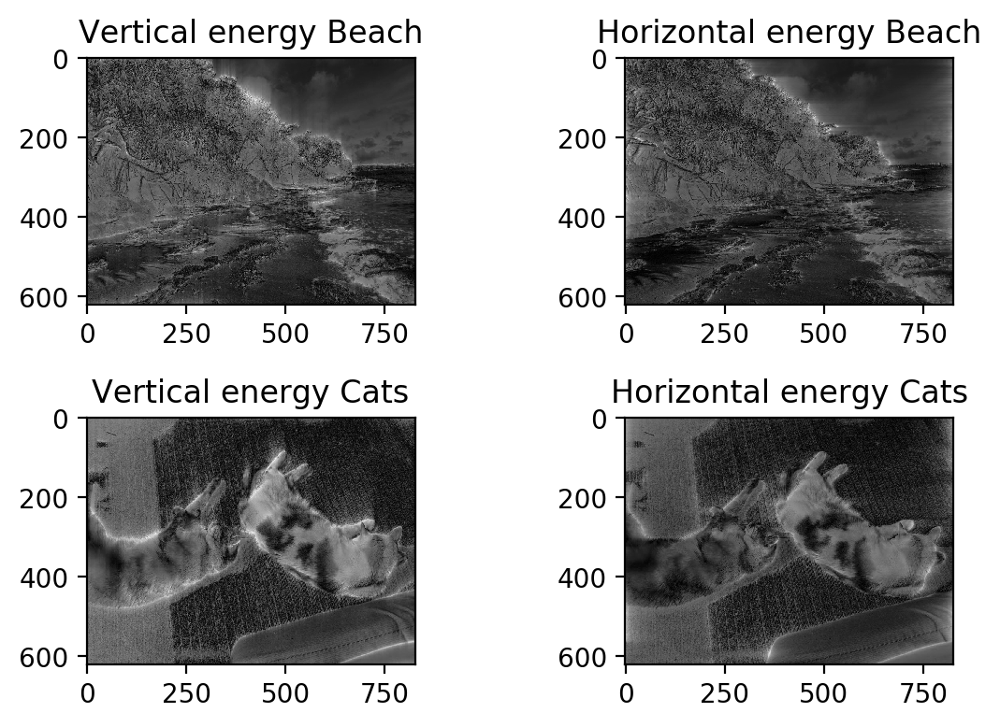

In [31]:
energy_x_beach = measure_energy_axis(beach,axis=0)
energy_y_beach = measure_energy_axis(beach,axis=1)

energy_x_cats = measure_energy_axis(cats,axis=0)
energy_y_cats = measure_energy_axis(cats,axis=1)

plt.subplot(2,2,1)
plt.imshow(energy_x_beach,cmap='Greys_r')
plt.title('Vertical energy Beach')

plt.subplot(2,2,2)
plt.imshow(energy_y_beach,cmap='Greys_r')
plt.title('Horizontal energy Beach')

plt.subplot(2,2,3)
plt.imshow(energy_x_cats,cmap='Greys_r')
plt.title('Vertical energy Cats')

plt.subplot(2,2,4)
plt.imshow(energy_y_cats,cmap='Greys_r')
plt.title('Horizontal energy Cats')

plt.tight_layout()

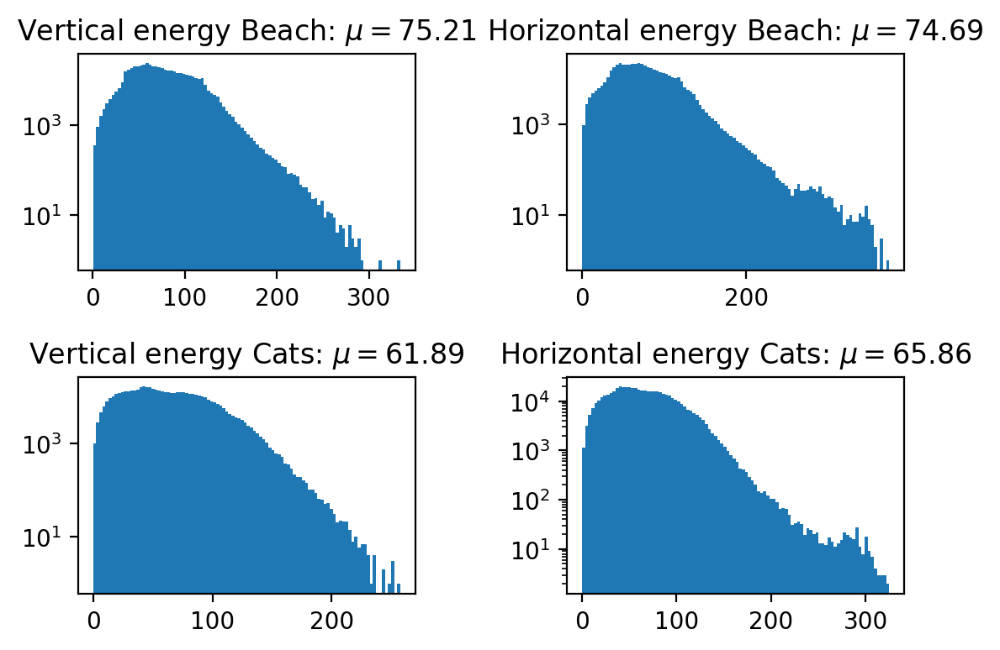

In [33]:
plt.subplot(2,2,1)
plt.hist(energy_x_beach.flatten(),log='y',bins=100)
plt.title('Vertical energy Beach: $\mu={:0.2f}$'.format(np.mean(energy_x_beach)))

plt.subplot(2,2,2)
plt.hist(energy_y_beach.flatten(),log='y',bins=100)
plt.title('Horizontal energy Beach: $\mu={:0.2f}$'.format(np.mean(energy_y_beach)))

plt.subplot(2,2,3)
plt.hist(energy_x_cats.flatten(),log='y',bins=100)
plt.title('Vertical energy Cats: $\mu={:0.2f}$'.format(np.mean(energy_x_cats)))

plt.subplot(2,2,4)
plt.hist(energy_y_cats.flatten(),log='y',bins=100)
plt.title('Horizontal energy Cats: $\mu={:0.2f}$'.format(np.mean(energy_y_cats)))
          
plt.tight_layout()

In terms of the shape, for the cosine-windowed image, they look like a linear falloff, but for the unwindowed image, they look more like a skewed Gaussian Distribution (but thetail is short). Maybe a Poisson is a better descriptor? Not sure.

Either way, the horizontal looks like it has more energy than vertical - though they numbers aren't convincing that the difference is significant.

In [34]:
def direction_Analysis(signal2d, func, nbins=20, sample=True, center=None):
    """
    Calculate a signal along radial profile.

    signal2d - 2d signal to be analyzed (not necessarily an signal_2ds)
    func - function to be applied to signal radially
    center - The [x,y] pixel coordinates used as the center. The default is 
             None, which then uses the center of the signal (including 
             fracitonal pixels).
    
    """
    # Calculate the indices from the signal_2ds
    y, x = np.indices(signal2d.shape)

    center = np.array([(x.max()-x.min())/2.0, (y.max()-y.min())/2.0])
    
    a = np.arctan2(( y - center[1]),(x - center[0]))
    #return(r) # can run imshow(r) to test correct

    ind = np.argsort(a.flat)
    a_sorted = a.flat[ind]
    i_sorted = signal2d.flat[ind]

    #digitize cleanly
    linbins = np.linspace(-np.pi,np.pi,nbins+1)
    a_digitized = np.take(linbins,np.digitize(a_sorted,linbins,right=True))

    #digitize by int
    # Get the integer part of the angle (bin size = 1)
    #a_digitized = a_sorted.astype(int)

    #if we are using a quantity that depends on population size, figure out the smallest population size in an angle
    #sample to reduce all angles to this number of samples.
    if(sample):
        from collections import Counter
        least_common = Counter(a_digitized).most_common()[-1]
        subset_size = least_common[1] #get number of values for least common

    angs = np.unique(a_digitized)
    vals= []
    for ang in angs:
        pxls = i_sorted[np.where(a_digitized == ang)]
        if(sample):
            pxls = np.random.choice(pxls, size=subset_size, replace=False) #take the smallest subset
        vals.append(func(pxls))

    return(angs, vals)

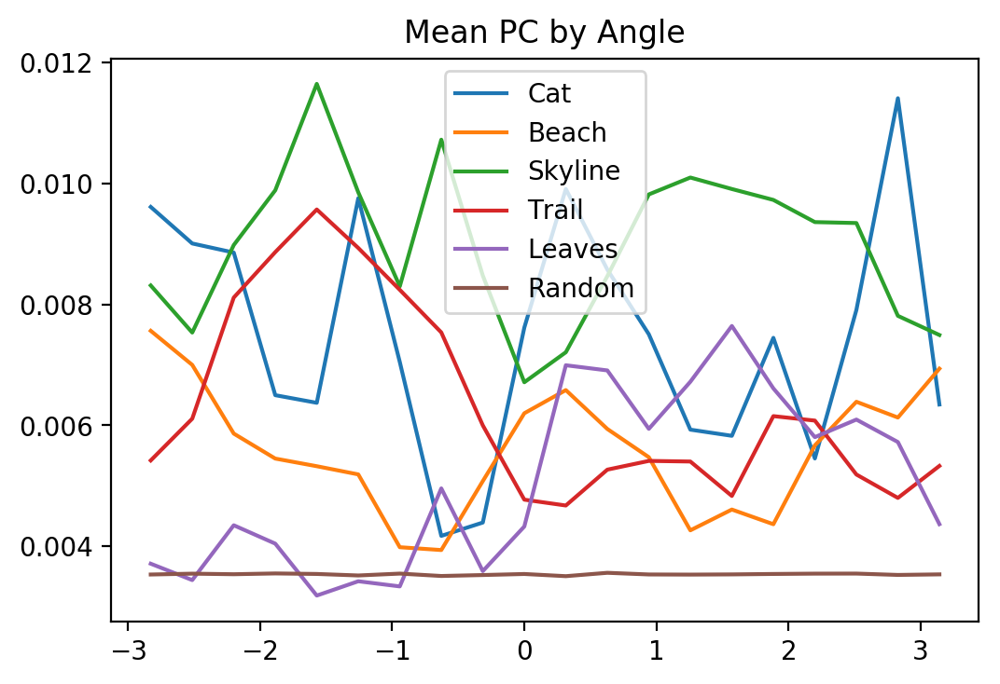

In [35]:
catangles, catmeanpc = direction_Analysis(pc_cats, np.mean)
beachangles, beachmeanpc = direction_Analysis(pc_beach,  np.mean)
trailangles, trailmeanpc = direction_Analysis(pc_trail,  np.mean)
skylineangles, skylinemeanpc = direction_Analysis(pc_skyline,  np.mean)
leavesangles, leavesmeanpc = direction_Analysis(pc_leaves,  np.mean)

pc_rand, pb_rand = measure_pc_2d(np.random.rand(*np.shape(cats)))
randangles, randmeanpc = direction_Analysis(pc_rand,  np.mean)

plt.plot(catangles, catmeanpc,label='Cat')
plt.plot(beachangles, beachmeanpc,label='Beach')
plt.plot(skylineangles, skylinemeanpc,label='Skyline')
plt.plot(trailangles, trailmeanpc,label='Trail')
plt.plot(leavesangles, leavesmeanpc,label='Leaves')
plt.plot(randangles, randmeanpc,label='Random')
plt.title('Mean PC by Angle')
plt.legend()

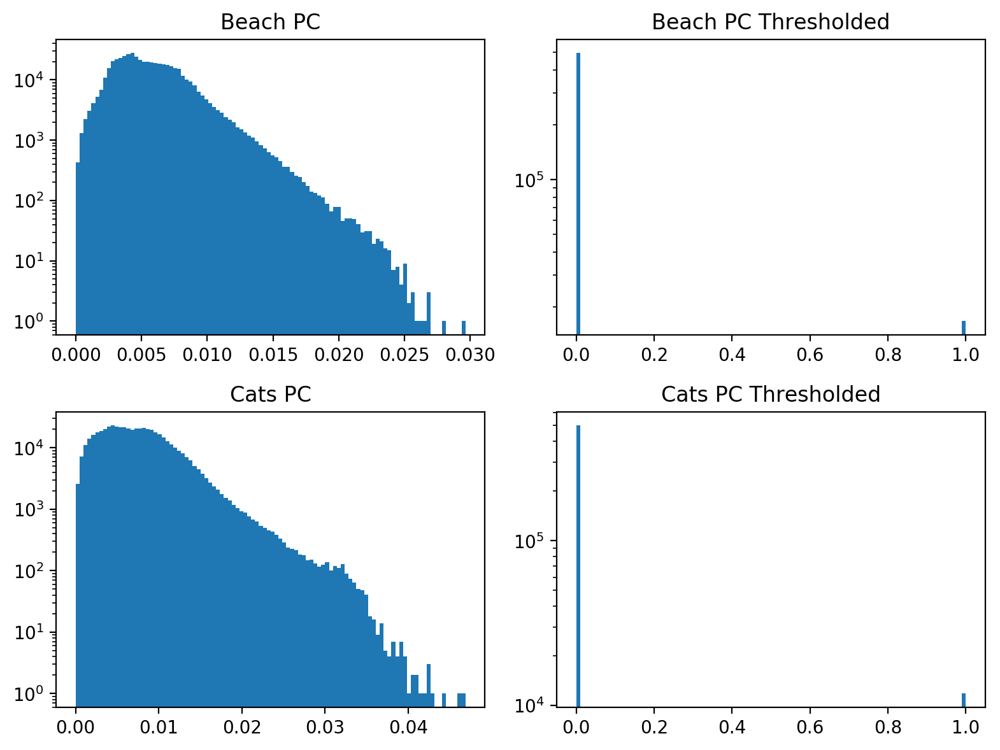

In [36]:
pc_beach_thresh = set_thresh(pc_beach)
pc_cats_thresh = set_thresh(pc_cats)

plt.figure(figsize=(8,6))

plt.subplot(2,2,1)
plt.hist(pc_beach.flatten(),log="y", bins=100)
plt.title('Beach PC')

plt.subplot(2,2,2)
plt.hist(pc_beach_thresh.flatten(), log="y", bins=100)
plt.title('Beach PC Thresholded')

plt.subplot(2,2,3)
plt.hist(pc_cats.flatten(), log="y", bins=100)
plt.title('Cats PC')

plt.subplot(2,2,4)
plt.hist(pc_cats_thresh.flatten(), log="y", bins=100)
plt.title('Cats PC Thresholded')

plt.tight_layout()

woah!!! Structure!!!

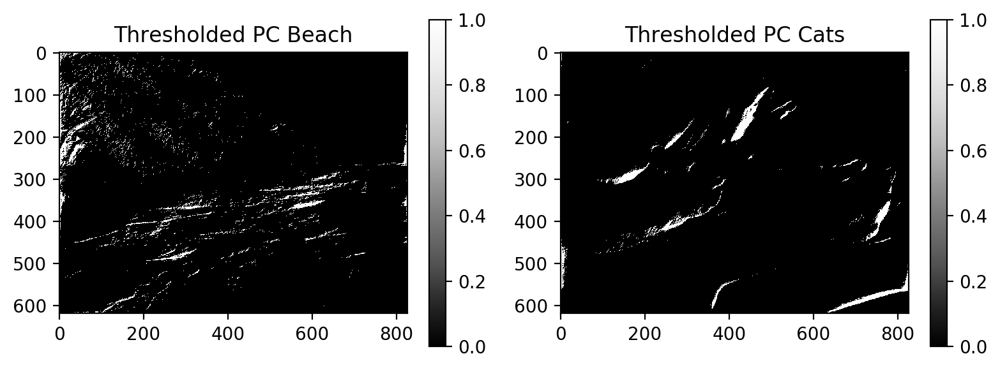

In [37]:
plt.figure(figsize=(8,3))

plt.subplot(1,2,1)
plt.imshow(pc_beach_thresh,cmap="Greys_r")
plt.title('Thresholded PC Beach')
plt.colorbar()

plt.subplot(1,2,2)
plt.imshow(pc_cats_thresh,cmap="Greys_r")
plt.title('Thresholded PC Cats')
plt.colorbar()

plt.tight_layout()

## Fit Histograms to the PC Distributions

In [138]:
def fitline_hist(datavec, nbins = 1000):
    
    #fit to a log-linear curve
    
    bin_heights, bin_borders, _ = plt.hist(datavec.flatten(), bins=nbins)
    bin_centers = (bin_borders[:-1] + bin_borders[1:]) / 2 #fit to centers of bins, not edges

    fit, resid, rank, sv, rcond = np.polyfit(x=bin_centers, y=np.log(1+bin_heights), deg=1, full=True)
    m,b = fit
    resid = resid[0]
    plt.semilogy(bin_centers,
                 np.exp(m*bin_centers+ b) - 1,
                 label='fit = exp({0:0.1f}x + {1:0.1f})-1, R={2:0.1f}'.format(m, b, resid))
    plt.legend()
    plt.title('M = {0:0.1f}, B = {1:0.1f}, Residual={2:0.1f}'.format(m,b,resid))
    #plt.hist(datavec.flatten(),log="y", bins=100)

def fitgauss_hist(datavec, nbins = 1000):
    
    datavec = datavec.flatten()*10
    
    #fit to a log-linear curve
    
    bin_heights, bin_borders, _ = plt.hist(datavec, bins=nbins, label='data')
    bin_centers = (bin_borders[:-1] + bin_borders[1:]) / 2 #fit to centers of bins, not edges

    #Gaussian with support for skewness
    def gauss_skew(x, amp, mu, sigma, alpha, c):
        #normal distribution
        normpdf = (1/(sigma*np.sqrt(2*math.pi)))*np.exp(-(np.power((x-mu),2)/(2*np.power(sigma,2))))
        normcdf = (0.5*(1+sp.erf((alpha*((x-mu)/sigma))/(np.sqrt(2)))))
        return (2*amp*normpdf*normcdf + c) * np.sign(sigma)
    #make an initial guess & fit
    init_guess = [np.max(bin_heights),np.mean(datavec), np.var(datavec), 1, 1]
    fitparms, fitcov = curve_fit(gauss_skew, bin_centers, bin_heights, p0=init_guess)
    #plot
    plt.plot(bin_centers, gauss_skew(bin_centers, *fitparms),
             label='SkewGauss: $\mu={0:0.2f}, \sigma={1:0.2f}, \delta={2:0.2f}$'.format(fitparms[1],fitparms[2],fitparms[3]))

#   vanilla gaussian distribution
    def gaus(x,amp,mu,sigma):
        #multiply by sign of sigma to make sure we get a positive value
        return amp*np.exp(-(x-mu)**2/(2*sigma**2))*np.sign(sigma)
    #make an initial guess & fit
    init_guess = [np.max(bin_heights),np.mean(datavec), np.var(datavec)]
    fitparms, fitcov = curve_fit(gaus, bin_centers, bin_heights, p0 = init_guess)
    #plot
    plt.plot(bin_centers, gaus(bin_centers, *fitparms),label='Gauss: $\mu={0:0.2f}, \sigma={1:0.2f}$'.format(fitparms[1],fitparms[2]))


    plt.legend(fontsize=6)
    
##TODO: Fit Rayleigh Distribution

/home/vasha/anaconda3/lib/python3.6/site-packages/scipy/optimize/minpack.py:785: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


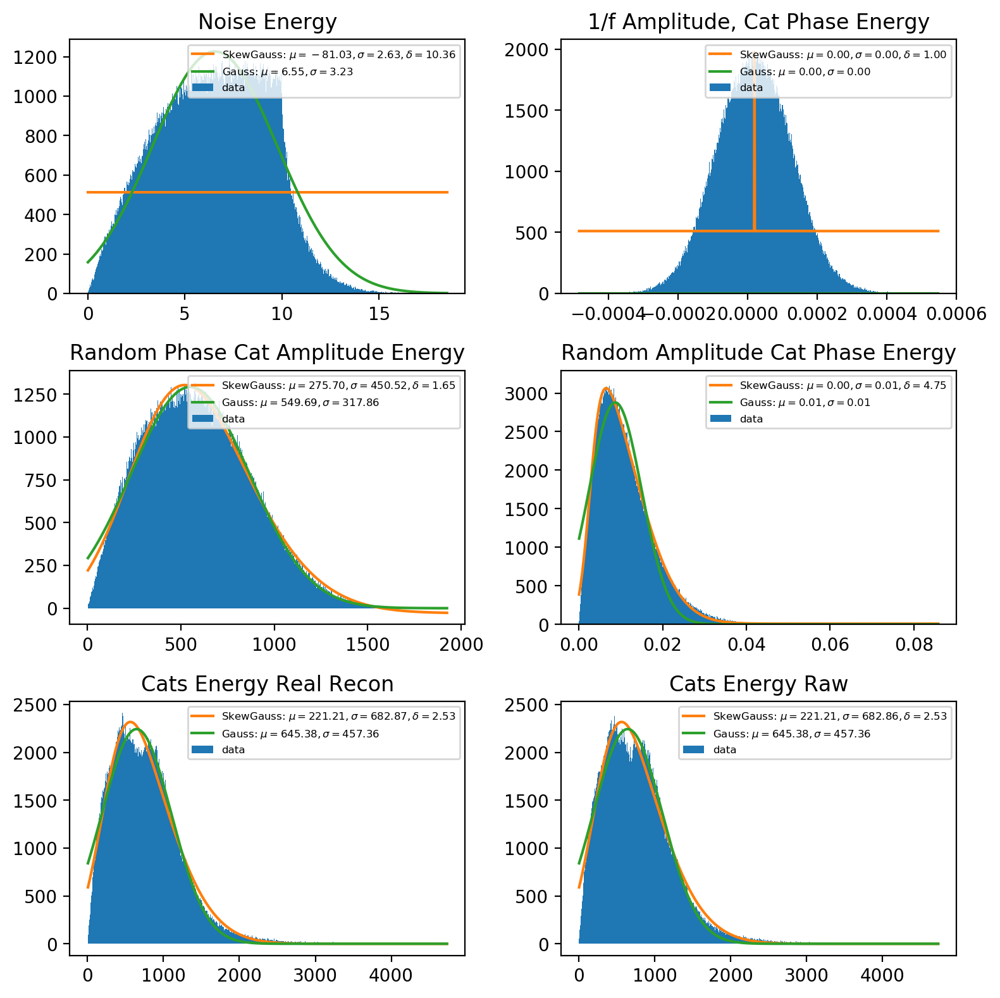

In [40]:
energy_noise, pb_noise = measure_energy_2d(np.real(random_noise))
energy_1f_cats, pb_1f_cats = measure_energy_2d(np.real(recon_onef_cats))
energy_rand_phase_cats_amp, pb_rand_phase_cats_amp = measure_energy_2d(np.real(recon_rand_phase_cats_1))
energy_cats_phase_rand_amp, pb_cats_phase_rand_amp = measure_energy_2d(np.real(recon_rand_cats))
energy_cats_recon, pb_cats_recon = measure_energy_2d(np.real(recon_cats))
energy_cats, pb_cats = measure_energy_2d(cats)

plt.figure(figsize=(8,8))

plt.subplot(3,2,1)
#plt.hist(energy_noise.flatten(),log="y", bins=100)
fitgauss_hist(energy_noise)
plt.title('Noise Energy')

plt.subplot(3,2,2)
#plt.hist(np.real(recon_onef_cats).flatten(),log="y", bins=100)
fitgauss_hist(recon_onef_cats)
plt.title('1/f Amplitude, Cat Phase Energy')

plt.subplot(3,2,3)
#plt.hist(energy_rand_phase_cats_amp.flatten(), log="y", bins=100)
fitgauss_hist(energy_rand_phase_cats_amp)
plt.title('Random Phase Cat Amplitude Energy')

plt.subplot(3,2,4)
#plt.hist(energy_cats_phase_rand_amp.flatten(), log="y", bins=100)
fitgauss_hist(energy_cats_phase_rand_amp)
plt.title('Random Amplitude Cat Phase Energy')

plt.subplot(3,2,5)
#plt.hist(energy_cats_recon.flatten(),log="y", bins=100)
fitgauss_hist(energy_cats_recon)
plt.title('Cats Energy Real Recon')

plt.subplot(3,2,6)
#plt.hist(energy_cats.flatten(),log="y", bins=100)
fitgauss_hist(energy_cats)
plt.title('Cats Energy Raw')

plt.tight_layout()

So interseting! The real images contain intersting distributions of energy, while the images composed with noise (EVEN those with REAL phase, and even with 1/f that LOOK like the image) don't have the same distribution. Woah!

Let's now look for differences between the distributions of different image categories

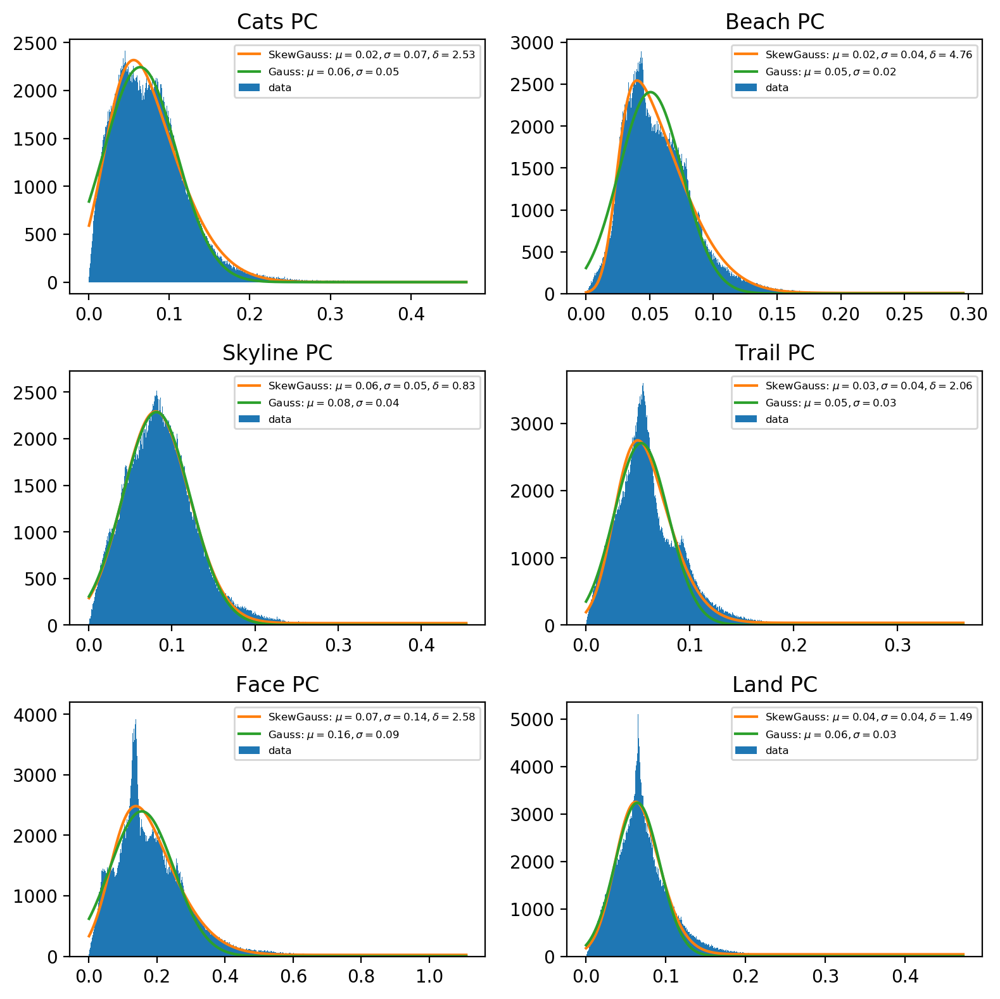

In [44]:
plt.figure(figsize=(8,8))

pccats = np.real(measure_pc_2d(cats)[0])
pcbeach = np.real(measure_pc_2d(beach)[0])
pcskyline = np.real(measure_pc_2d(skyline)[0])
pctrail = np.real(measure_pc_2d(trail)[0])
pcface = np.real(measure_pc_2d(face)[0])
pcland = np.real(measure_pc_2d(land)[0])


fitline_hist(pcskyline, 100)

plt.subplot(3,2,1)
fitgauss_hist(pccats)
#plt.hist(pccats.flatten(),log="y", bins=100)
plt.title('Cats PC')

plt.subplot(3,2,2)
#plt.hist(pcbeach.flatten(),log="y", bins=100)
fitgauss_hist(pcbeach)
plt.title('Beach PC')

plt.subplot(3,2,3)
#plt.hist(pcskyline.flatten(),log="y", bins=100)
fitgauss_hist(pcskyline)
plt.title('Skyline PC')

plt.subplot(3,2,4)
#plt.hist(pctrail.flatten(),log="y", bins=100)
fitgauss_hist(pctrail)
plt.title('Trail PC')

plt.subplot(3,2,5)
#plt.hist(pcface.flatten(),log="y", bins=100)
fitgauss_hist(pcface)
plt.title('Face PC')

plt.subplot(3,2,6)
#plt.hist(pcland.flatten(),log="y", bins=100)
fitgauss_hist(pcland)
plt.title('Land PC')

plt.tight_layout()

## Fourier Transform of PC

The distribution of the PC values themselves does not appear sufficient to contain the structure. I suspect this is because the pointwise autocorrelation is not accounted for. Said differently, the correct PC and PB values are present, but they are not spatially clumped such that they form edges and shapes. The Fourier transform allows us to calculate autocorrelation values, let's see if we can use it to take into account spatial correlations in the PC space.

In [42]:
cats_pc_fts = np.fft.fftshift(np.fft.fft2(pc_cats))
onef_pc_fts = np.fft.fftshift(np.fft.fft2(pc_cats))
outdoorman_pc_fts = np.array([np.fft.fftshift(np.fft.fft2(imr.cosine_window(im))) for im in outdoorman_pc])
onef_pc_fts = np.array([np.fft.fftshift(np.fft.fft2(imr.cosine_window(im))) for im in onef_pc])
rand_pc_fts = np.array([np.fft.fftshift(np.fft.fft2(imr.cosine_window(im))) for im in rand_pc])
gaus_pc_fts = np.array([np.fft.fftshift(np.fft.fft2(imr.cosine_window(im))) for im in gaus_pc])

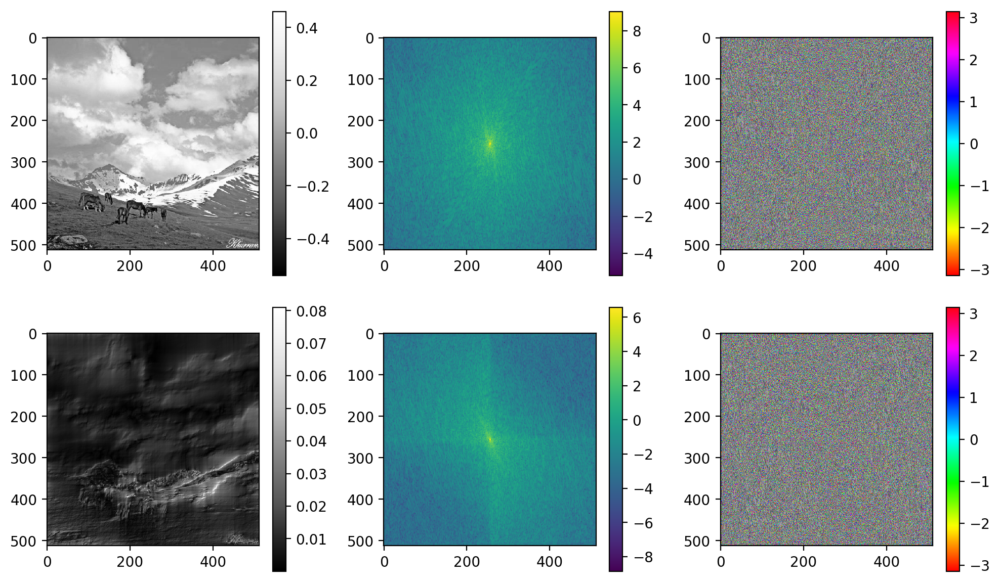

In [50]:
imnum = 12

plt.figure(figsize=(10,6))

plt.subplot(2,3,1)
plt.imshow(outdoornat_ims[imnum],cmap='Greys_r')
plt.colorbar()

imft = np.fft.fftshift(np.fft.fft2(imr.cosine_window(outdoornat_ims[imnum])))

plt.subplot(2,3,2)
plt.imshow(np.log(np.abs(imft)))
plt.colorbar()

plt.subplot(2,3,3)
plt.imshow(np.real(np.angle(imft)),cmap='hsv')
plt.colorbar()

plt.subplot(2,3,4)
plt.imshow(outdoornat_pc[imnum],cmap='Greys_r')
plt.colorbar()

plt.subplot(2,3,5)
plt.imshow(np.log(np.abs(outdoornat_pc_fts[imnum])))
plt.colorbar()

plt.subplot(2,3,6)
plt.imshow(np.real(np.angle(outdoornat_pc_fts[imnum])),cmap='hsv')
plt.colorbar()

plt.tight_layout()


## Ideas for What to Exlplore:
(bold when done)

- **Mixing Phase & Amplitude for two images**
- Combining Image Phase w/ 1/f spectrum (Do we need to normalize this somehow, or add noise to it?) Generate with random sine waves instead?)
- **Write a Phase Congruency Function**
- **Calculate Phase Congruency in image (and look at distribution)**
- **Looks like phase is most ineteresting in low frequency components - can we throw other parts away? (This ended up being an artifact in the non cosine-windowed FT)**
- **LOCAL phase! This seems to be what is important.**
- **Look at azimuthal average of phase. Plot this with a wrapping color scheme**
- **Can we make the cosine window smaller, so more of the image is retained? ALso, for phase congruency, maybe the cosine window is not needed?**
- **What is the distribution of local phase, and phases with relation to their contributing frequencies? Said differently, we should be able to differentiate between 'roofs', 'troughs' and 'edges' based on the value of $\bar{\phi}$. To see this we can plot images as heatmaps with $\bar{\phi}$ as the color, and saturation as the PC value.**

- The PC distributions may actually be Rayleigh distributions, as values for randomly distributed $E$ values will be, and $E^2$ values will have $\chi^2$ distributions. (see Kovesi 1999 eqs3,4&5). Fit to these

- We need to go beyond just the distriubtions of phase congruency values. We need correlation among nearby pixels in the PC plot. This should give us real edges.


- Hypothesis: Natural image will have a specific distrituion of local energy (that includes high components) whereas noise will NOT. Random phase images still contain some phase congruency, so explore this.

- Use Phase Congruency instead of Energy for comparing distributions to put them all on the same axis


http://cvpr11.cecs.anu.edu.au/files/PhaseCongCVPR.pdf